## Investigating why HiTS2014 coadds aren't working as expected

All of the commands to process the data and build coadds seem to work as usual, but the result is... weird.

Making plots will hopefully help me figure out why.

**TL;DR**

The best seeing selector presently does not specify that we want maximal coverage of each patch on the sky. Instead, it selects some number of images with good seeing from various visits/ccds in a given patch that may or may not overlap. This notebook contains the code used to investigate this issue (alongside lots of ds9 mosaic plots).

In [1]:
import matplotlib.pyplot as plt
%matplotlib notebook
import numpy as np
import lsst.daf.persistence as dafPersist
import lsst.afw.geom as afwGeom
from lsst.pipe.base import Struct
from astropy.visualization import (ZScaleInterval, SqrtStretch, ImageNormalize)

In [2]:
import lsst.afw.display as afwDisplay
afwDisplay.setDefaultBackend("matplotlib")

In [3]:
# Multiple butlers: one for the first run (butler1)
# and then two more for a new attempt at best seeing coadds ("good") and for just coadding all the things ("all")
butler1 = dafPersist.Butler('/project/mrawls/hits2014/coadds1')
butler_good = dafPersist.Butler('/project/mrawls/hits2014/coadds_good')
#butler_all = dafPersist.Butler('/project/mrawls/hits2014/coadds_all')

## These patches are the ones that apparently successfully made coadds

In [4]:
patchesMini = ['10,3', '10,4', '10,5', '10,6', 
               '11,3', '11,4', '11,5',
               '12,3', '12,4', '12,5',
               '13,3', '13,4', '13,5',
               '14,4', '14,5',
               '8,5', '8,6',
               '9,3', '9,4', '9,5', '9,6']

print(len(patchesMini))

patchesAll = ['7,10','7,9',
              '8,10','8,11','8,12','8,5','8,6','8,8','8,9',
              '9,10','9,11','9,12',#'9,13',
              '9,3','9,4','9,5','9,6','9,7','9,8','9,9',
              '10,10','10,11','10,12',#'10,13',
              '10,3','10,4','10,5','10,6','10,7','10,8','10,9',
              '11,10','11,11','11,12',#'11,13',
              '11,3','11,4','11,5','11,6','11,7','11,8','11,9',
              '12,10','12,11','12,12','12,3','12,4','12,5','12,6','12,7','12,8','12,9',
              '13,10','13,11','13,3','13,4','13,5','13,6','13,7','13,8','13,9',
              '14,4','14,5','14,6','14,7',
              #'17,18',
              #'18,18','18,19',
              #'19,18','19,19',
              '22,27','22,28','22,29','22,30','22,31',
              '23,27','23,28','23,29','23,30','23,31','23,32',
              '24,27','24,28','24,29','24,30','24,31','24,32',
              '25,27','25,28','25,29','25,30','25,31',#'25,32',
              '26,27','26,28','26,29','26,30','26,31',#'26,32',
              '27,27','27,28','27,29','27,30','27,31',
              '28,29','28,30']

print(len(patchesAll))

21
96


## Working with just a single patch to start

In [5]:
dataId1 = {'filter': 'g', 'patch': '11,9', 'tract': 0}

In [6]:
plt.figure()
coadd1 = butler1.get('deepCoaddPsfMatched', dataId=dataId1)
norm = ImageNormalize(coadd1.getImage().getArray(), interval=ZScaleInterval(), stretch=SqrtStretch())
title = np.array2string(coadd1.getInfo().getCoaddInputs().visits['id'])
#disp1 = afwDisplay.Display(1)
#disp1.scale('asinh', 'zscale')
#disp1.mtv(coadd1.getImage(), title=title)
plt.imshow(coadd1.getImage().getArray(), norm=norm, cmap='gray')

<IPython.core.display.Javascript object>

In [7]:
plt.figure()
coadd2 = butler_good.get('deepCoaddPsfMatched', dataId=dataId1)
norm = ImageNormalize(coadd2.getImage().getArray(), interval=ZScaleInterval(), stretch=SqrtStretch())
title = np.array2string(coadd2.getInfo().getCoaddInputs().visits['id'])
plt.imshow(coadd2.getImage().getArray(), norm=norm, cmap='gray')

<IPython.core.display.Javascript object>

In [8]:
visitIds = [int(visit) for visit in coadd1.getInfo().getCoaddInputs().visits['id']]
print(visitIds)

[289449, 292413]


In [9]:
wcs1 = coadd1.getInfo().getWcs()
print(wcs1.getSkyOrigin())
print(wcs1.getPixelScale())
# do something to plot in sky coordinates ...

(152.928680, -2.301262)
1.61443e-06 rad


In [11]:
warp1 = butler_good.get('deepCoadd_psfMatchedWarp', dataId={'visit': visitIds[0], 'tract': 0, 'patch': '11,9'})
warp2 = butler_good.get('deepCoadd_psfMatchedWarp', dataId={'visit': visitIds[1], 'tract': 0, 'patch': '11,9'})
# etc...

In [12]:
print(coadd1.getInfo().getCoaddInputs().ccds)
print(warp1.getInfo().getCoaddInputs().ccds)

   id    bbox_min_x bbox_min_y bbox_max_x ... goodpix       weight       filter
            pix        pix        pix     ...                                  
-------- ---------- ---------- ---------- ... ------- ------------------ ------
28944941          0          0       2047 ... 3278709 31.832358779154184      g
28944934          0          0       2047 ... 1573097 31.832358779154184      g
28944947          0          0       2047 ... 3283858 31.832358779154184      g
28944935          0          0       2047 ...  180609 31.832358779154184      g
28944933          0          0       2047 ...  155748 31.832358779154184      g
28944946          0          0       2047 ... 3181836 31.832358779154184      g
29241341          0          0       2047 ... 3191863 1.4182683034998274      g
29241347          0          0       2047 ... 3197340 1.4182683034998274      g
29241334          0          0       2047 ... 1365433 1.4182683034998274      g
29241335          0          0       204

## Plot some patches using afwDisplay

<IPython.core.display.Javascript object>


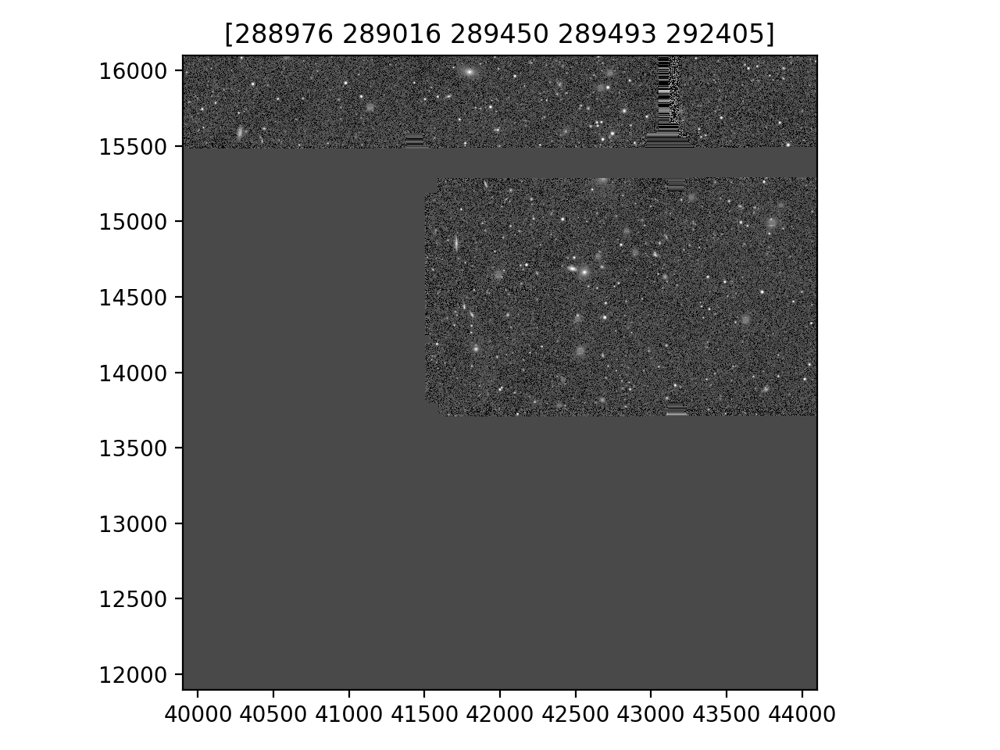

<IPython.core.display.Javascript object>


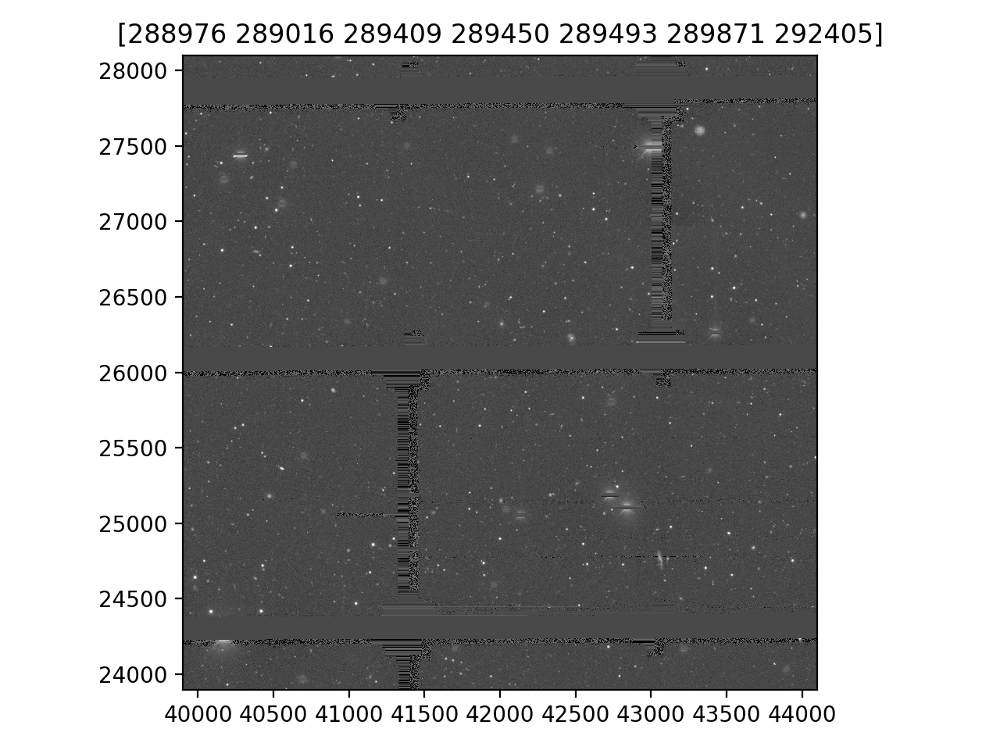

<IPython.core.display.Javascript object>


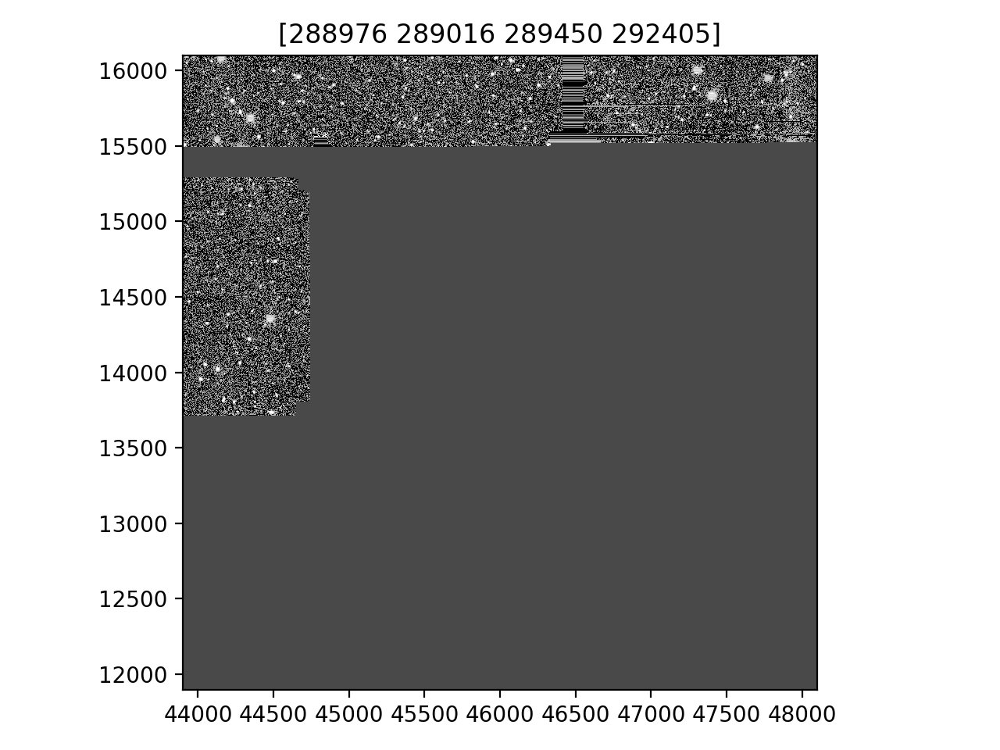

<IPython.core.display.Javascript object>


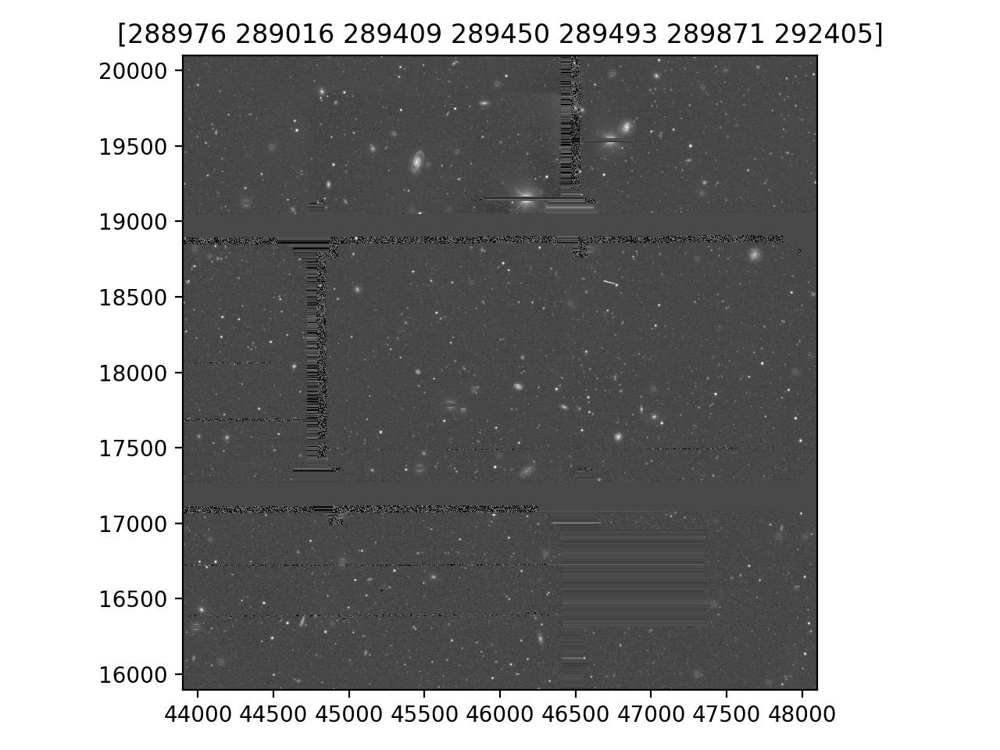

<IPython.core.display.Javascript object>


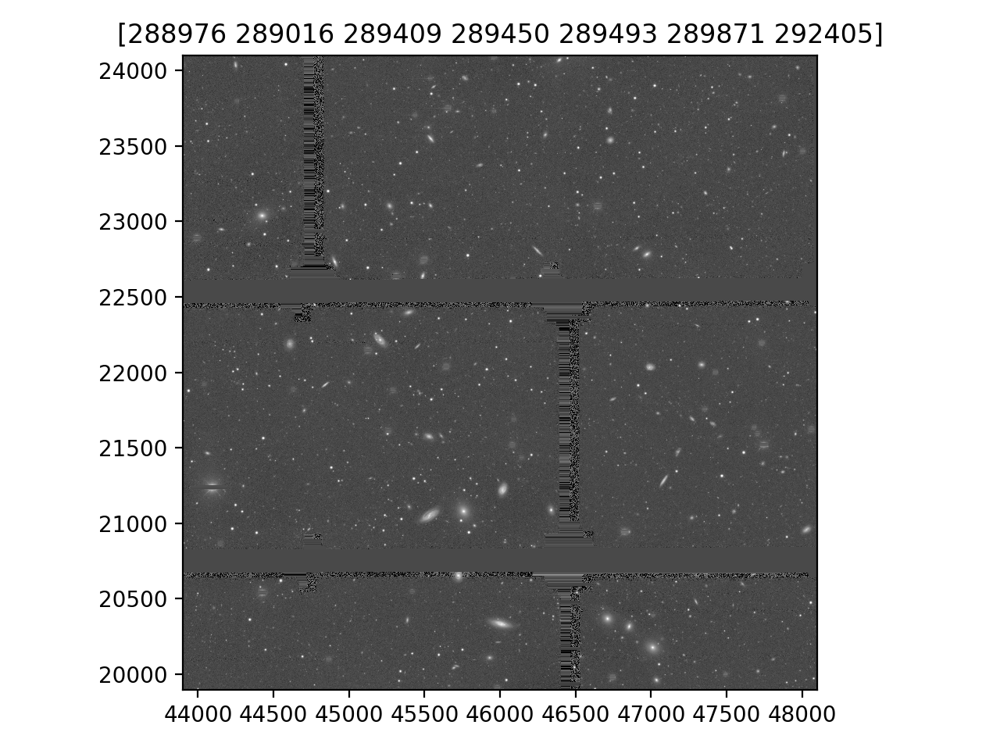

<IPython.core.display.Javascript object>


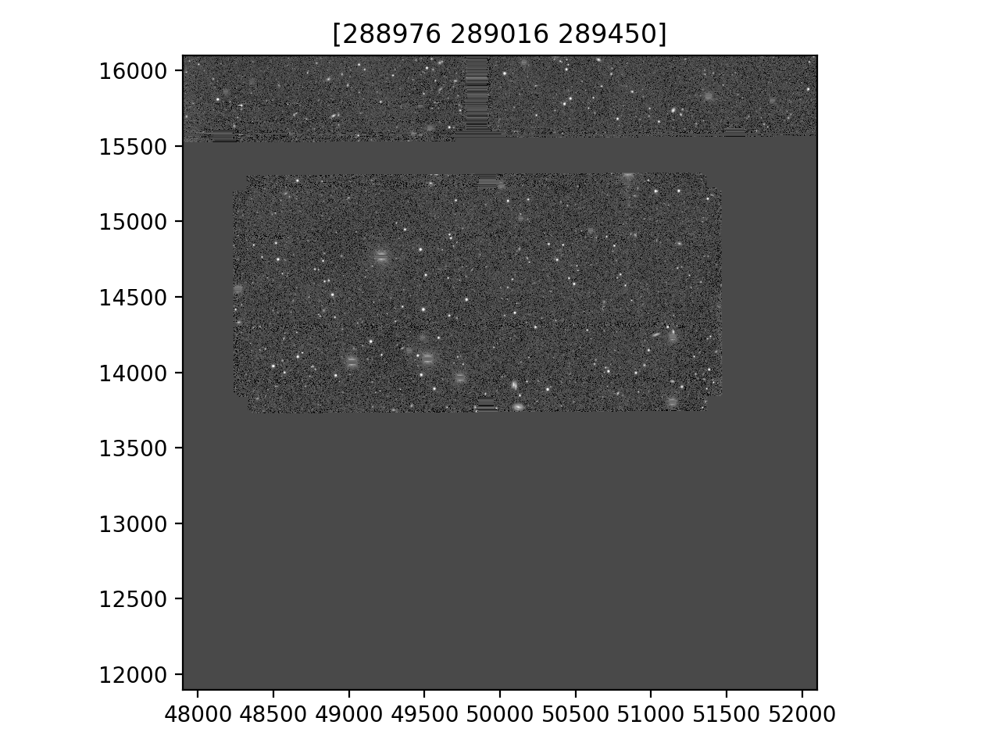

<IPython.core.display.Javascript object>


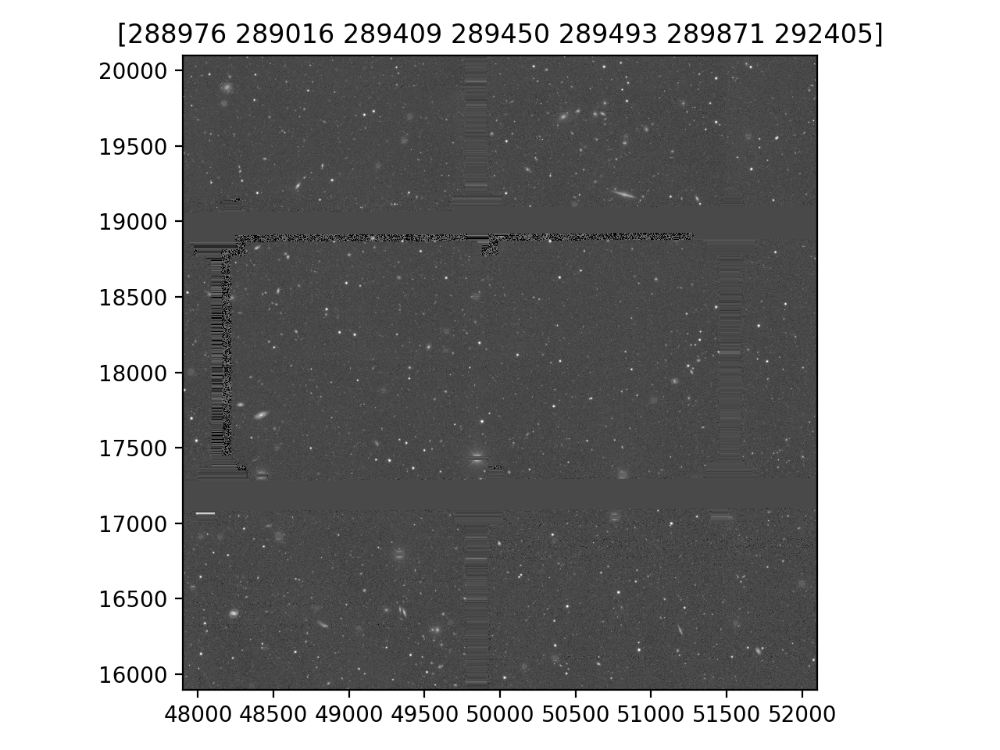

<IPython.core.display.Javascript object>


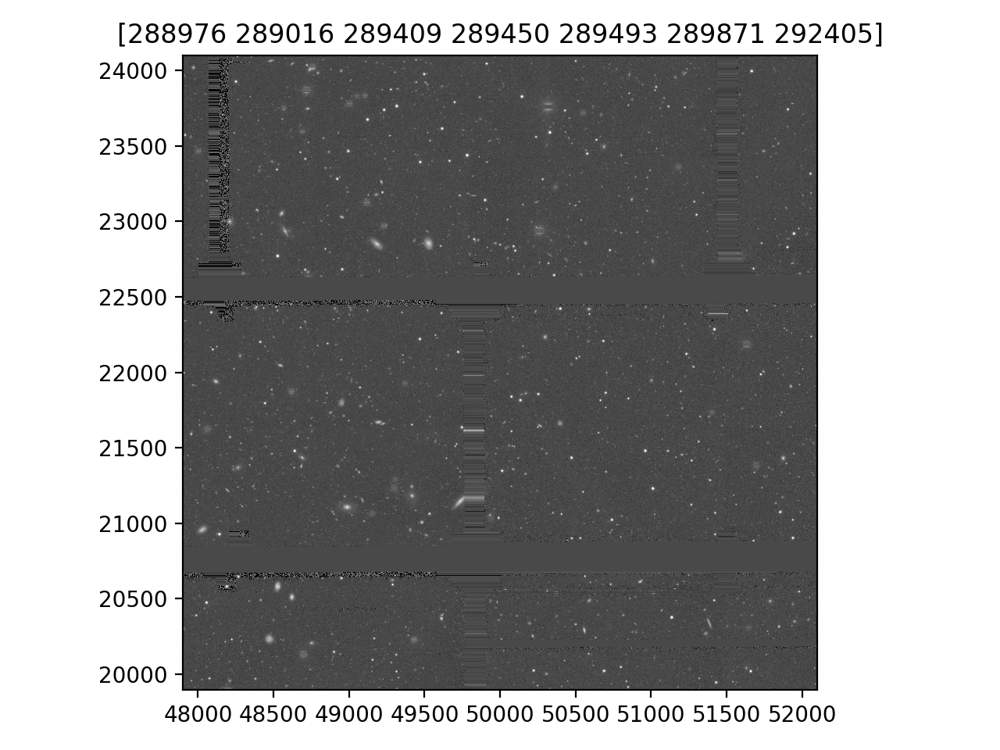

<IPython.core.display.Javascript object>


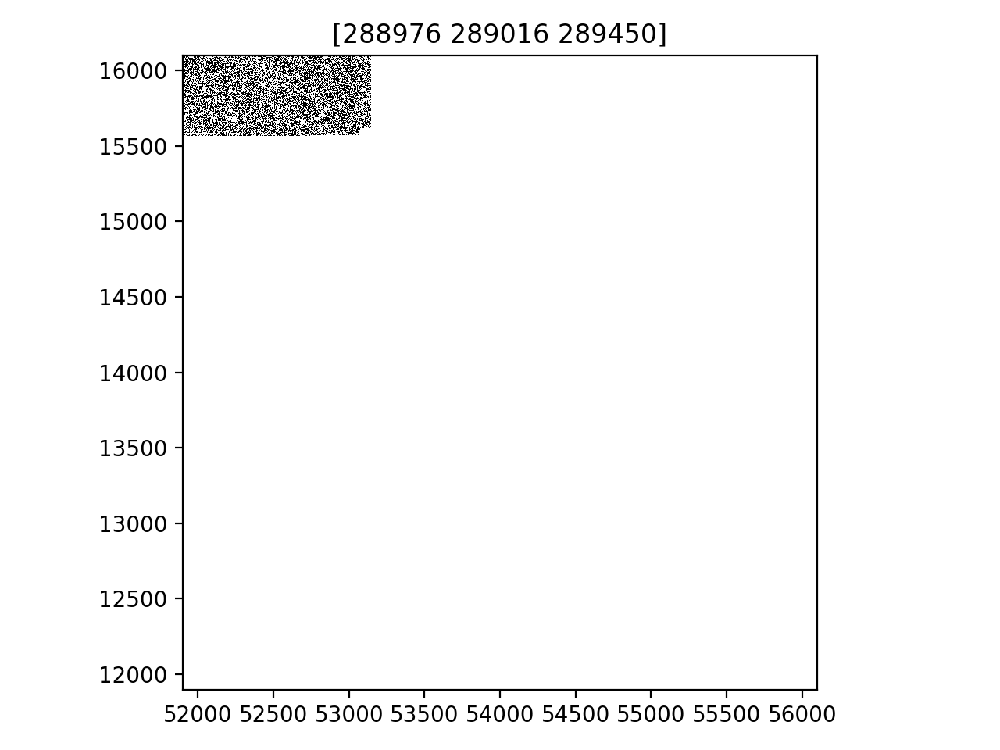

<IPython.core.display.Javascript object>


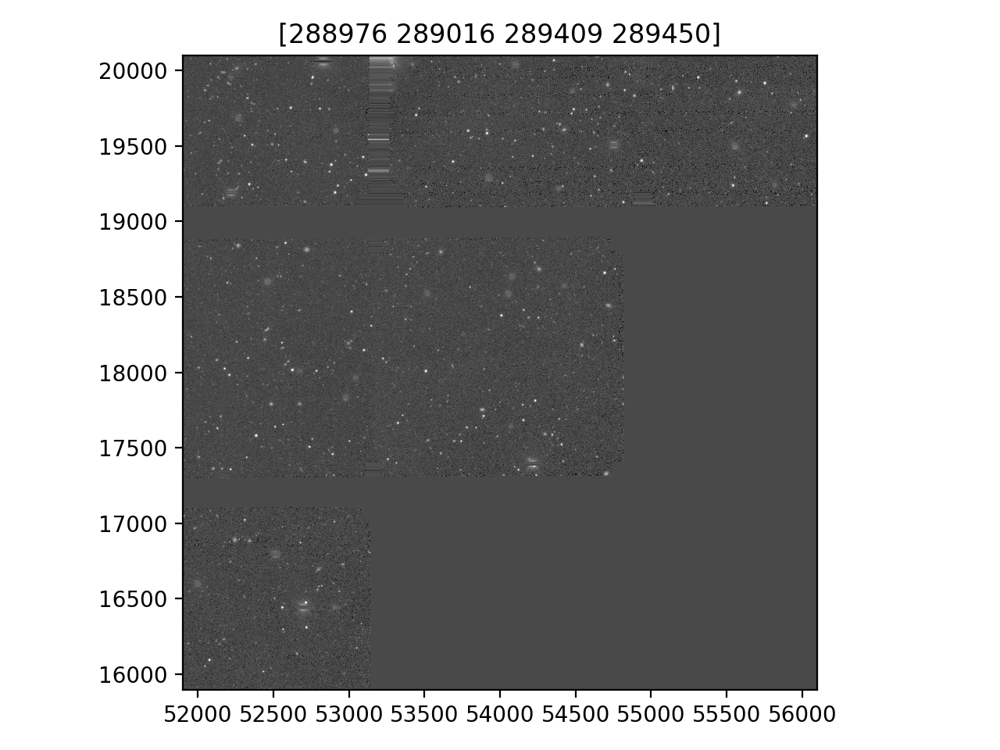

<IPython.core.display.Javascript object>


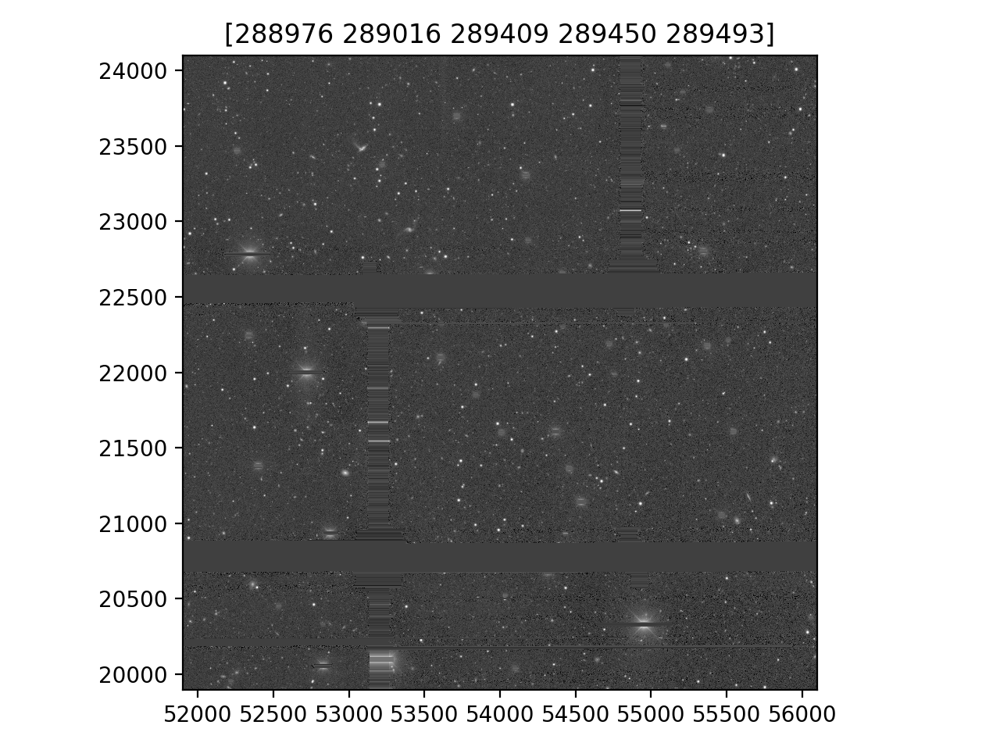

<IPython.core.display.Javascript object>


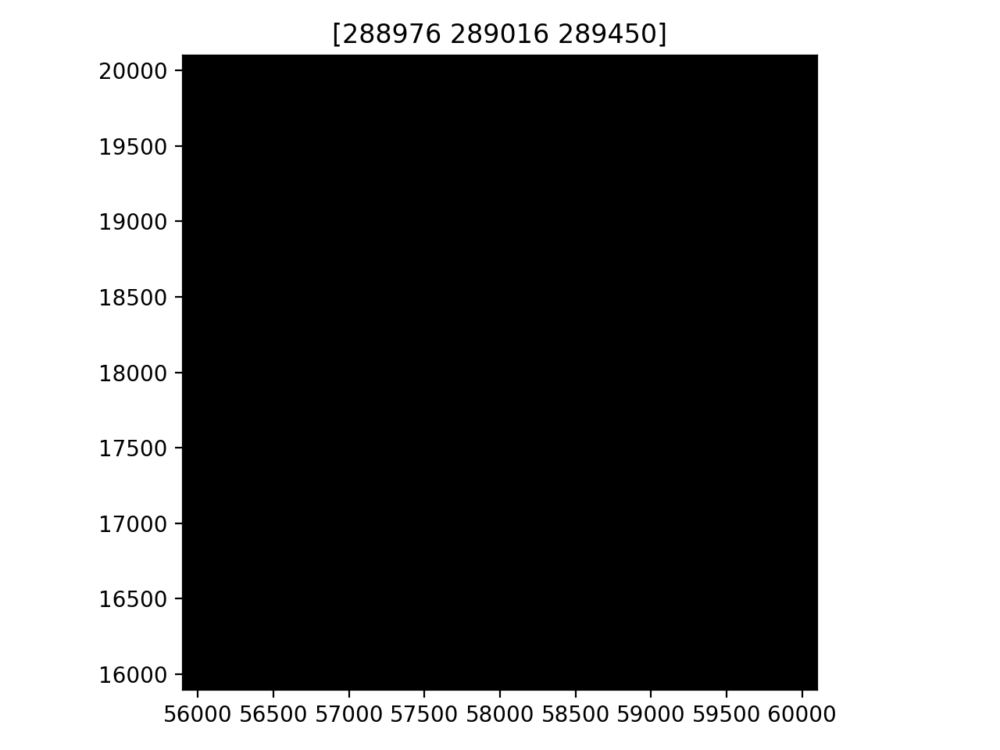

<IPython.core.display.Javascript object>


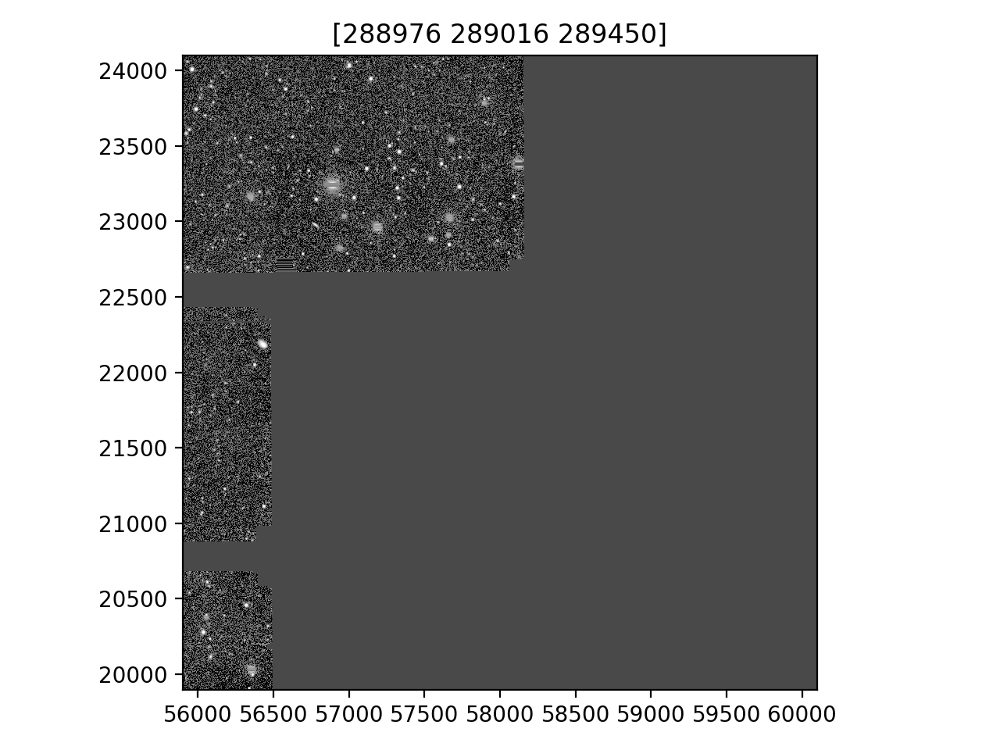

<IPython.core.display.Javascript object>


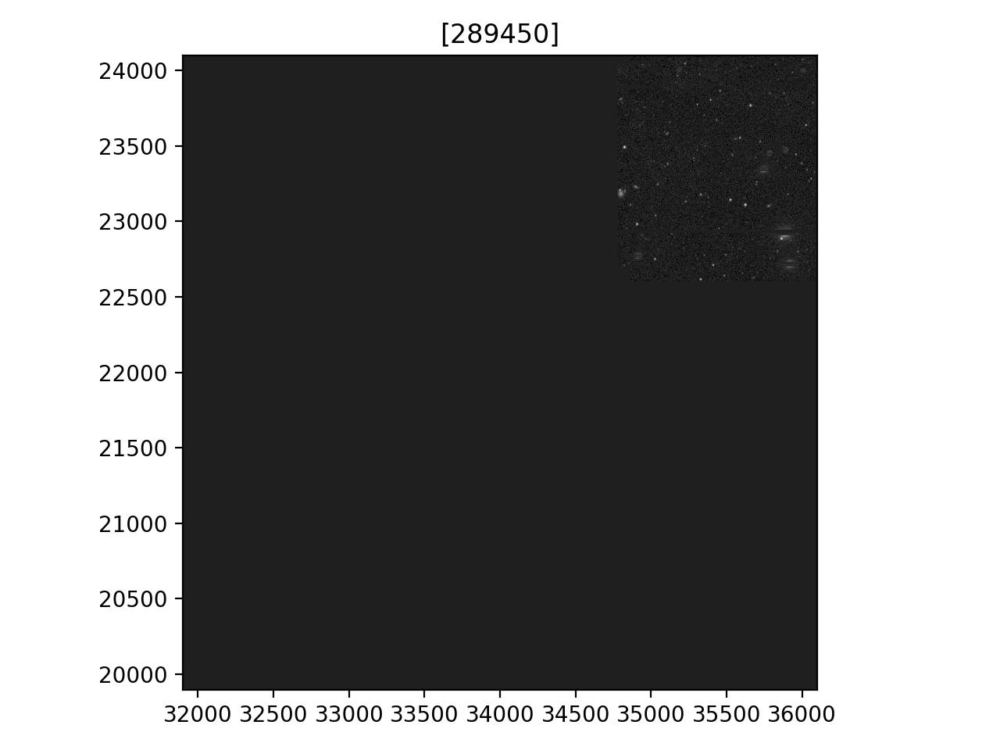

<IPython.core.display.Javascript object>


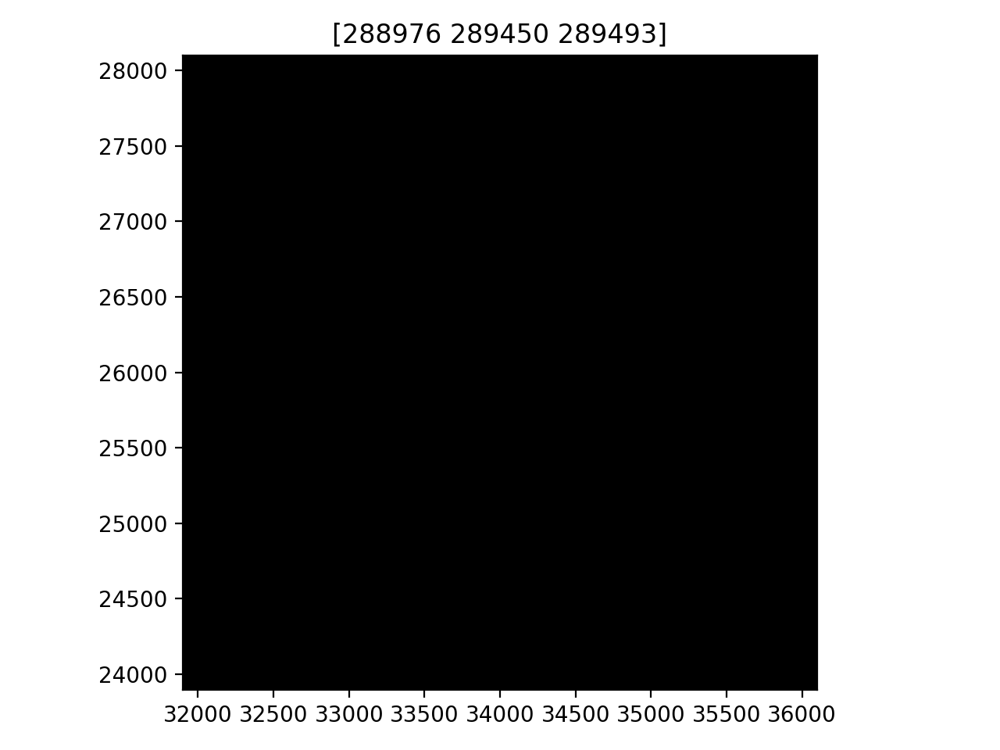

<IPython.core.display.Javascript object>


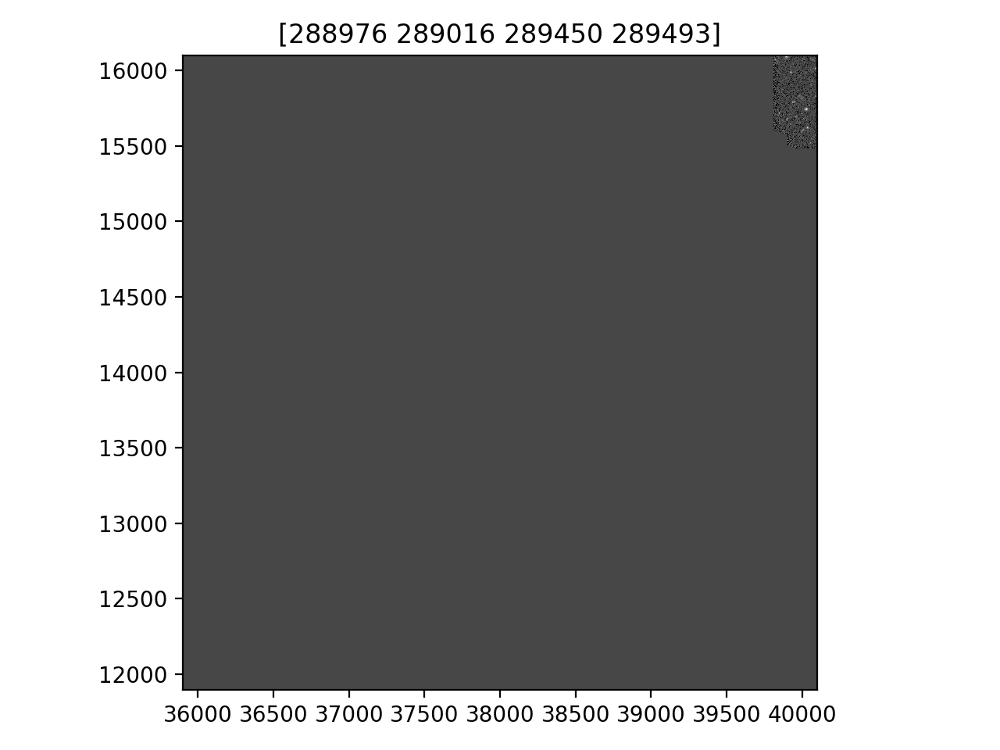

<IPython.core.display.Javascript object>


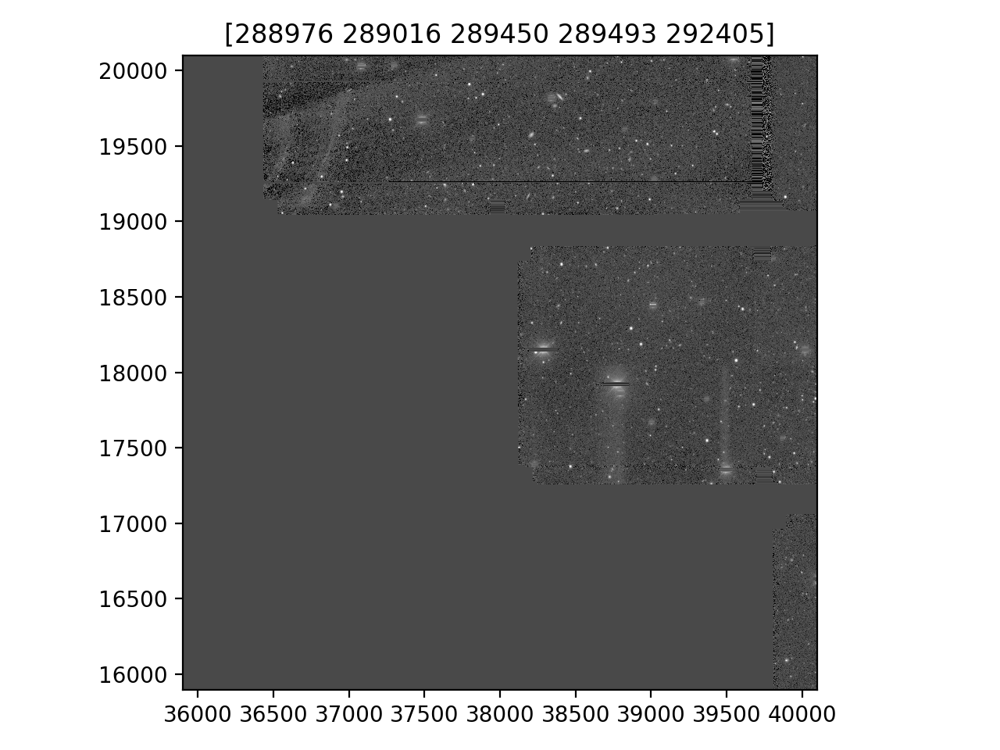

<IPython.core.display.Javascript object>


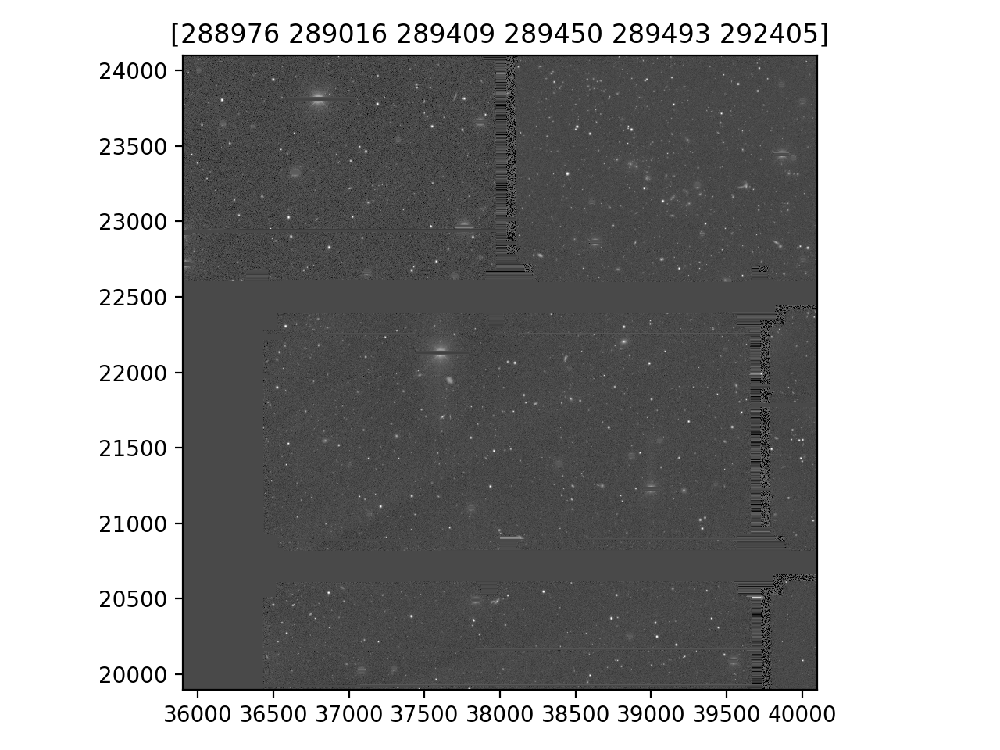

/software/lsstsw/stack_20181012/python/miniconda3-4.5.4/envs/lsst-scipipe/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


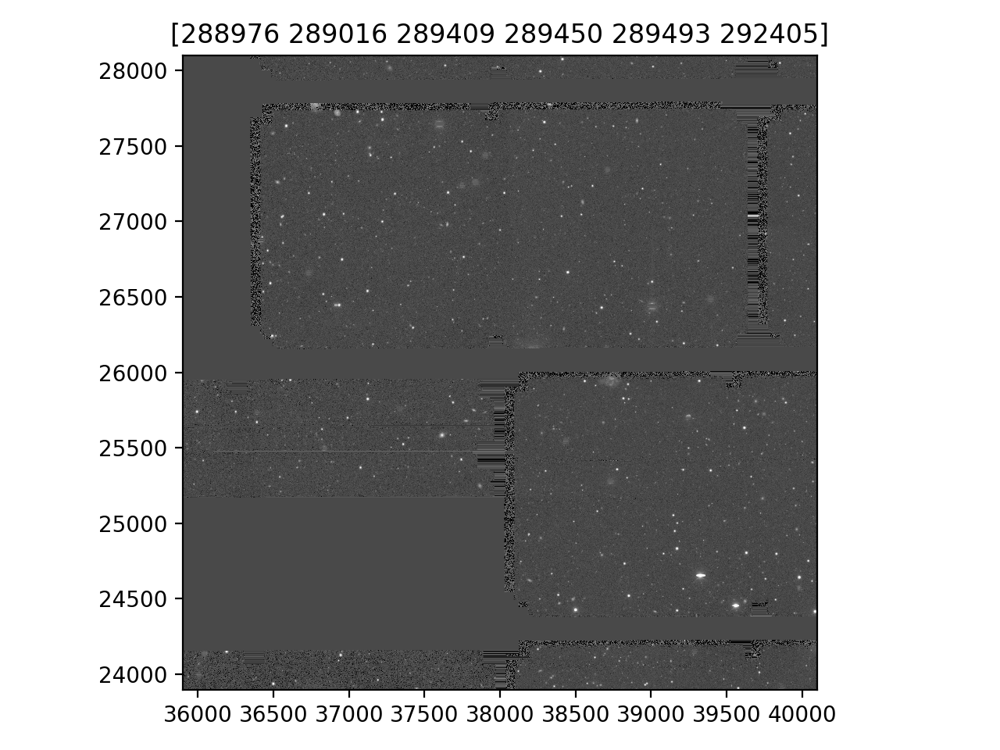

In [13]:
for idx, patch in enumerate(patchesMini):
    coaddDataId = {'filter': 'g', 'tract': 0, 'patch': patch}
    try:
        coadd = butler_good.get('deepCoaddPsfMatched', dataId=coaddDataId)
        visits = coadd.getInfo().getCoaddInputs().visits['id']
        title = np.array2string(visits)
        disp = afwDisplay.Display(idx)
        disp.scale('asinh', 'zscale')
        disp.mtv(coadd.getImage(), title=title)
    except:
        print('FAILED TO DISPLAY patch', patch)

## Same as the above, but using matplotlib

/software/lsstsw/stack_20181012/python/miniconda3-4.5.4/envs/lsst-scipipe/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


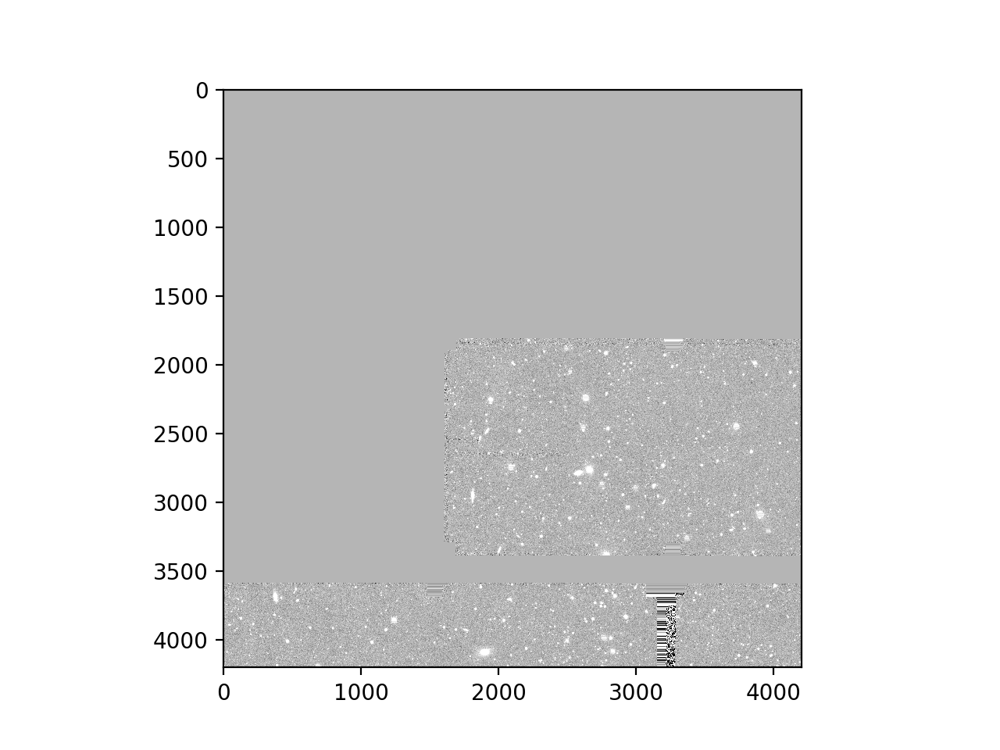

<IPython.core.display.Javascript object>


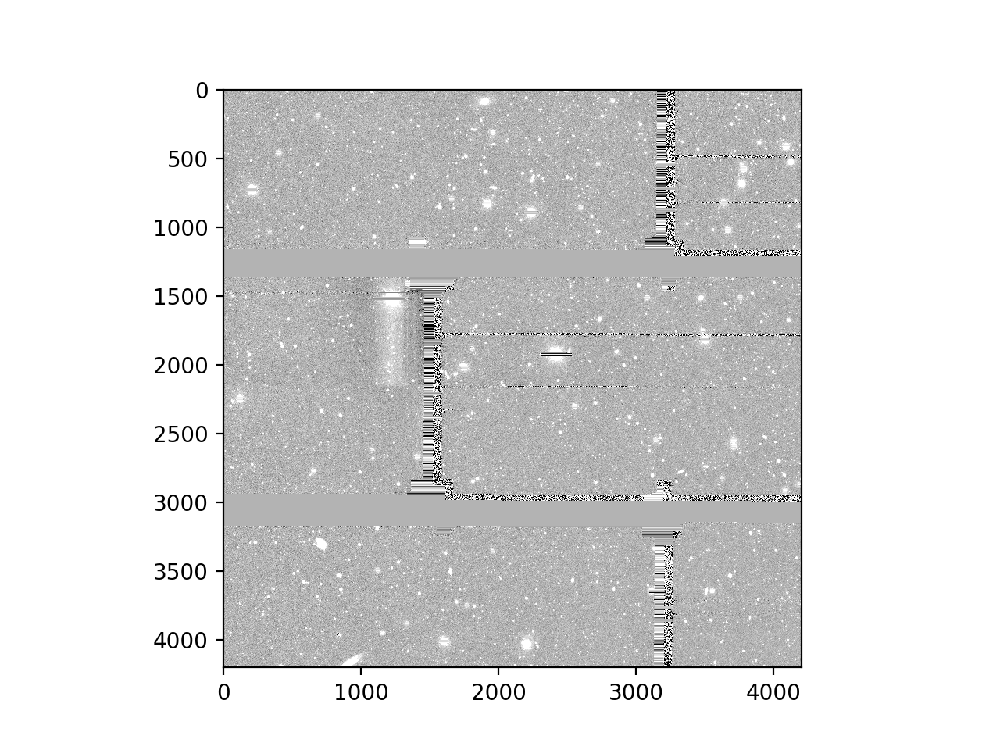

<IPython.core.display.Javascript object>


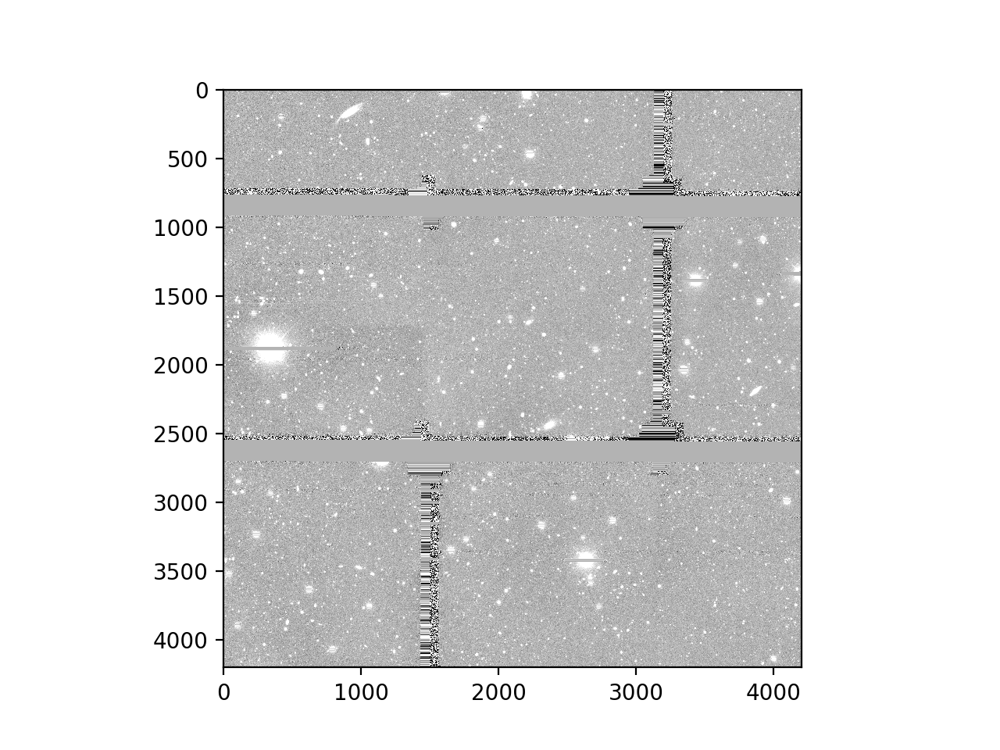

<IPython.core.display.Javascript object>


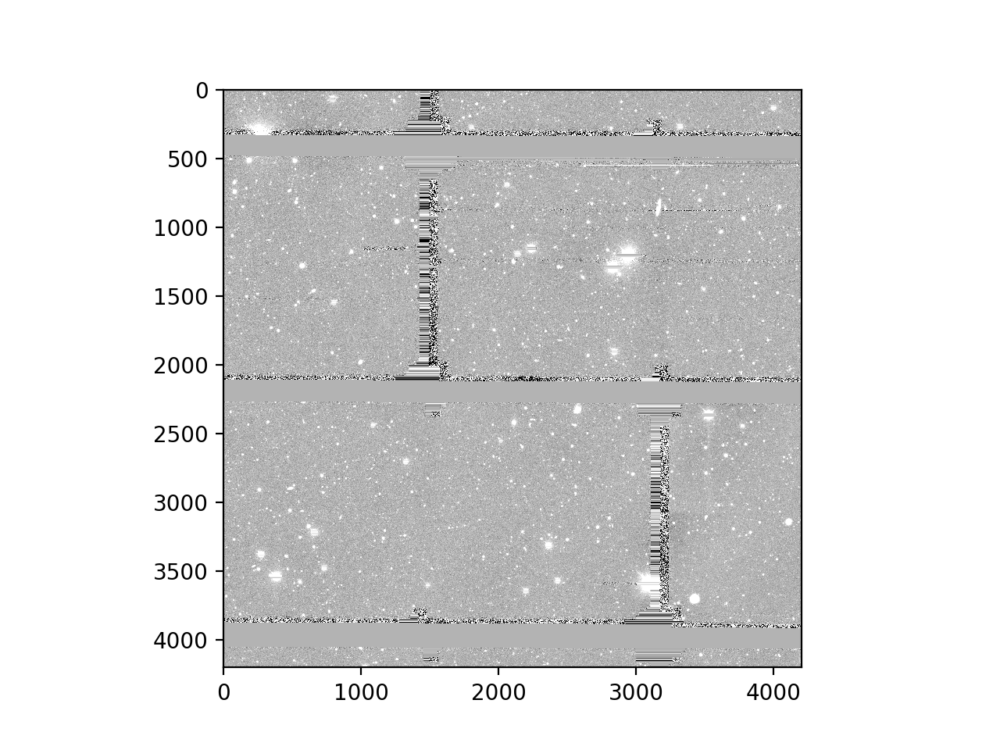

<IPython.core.display.Javascript object>


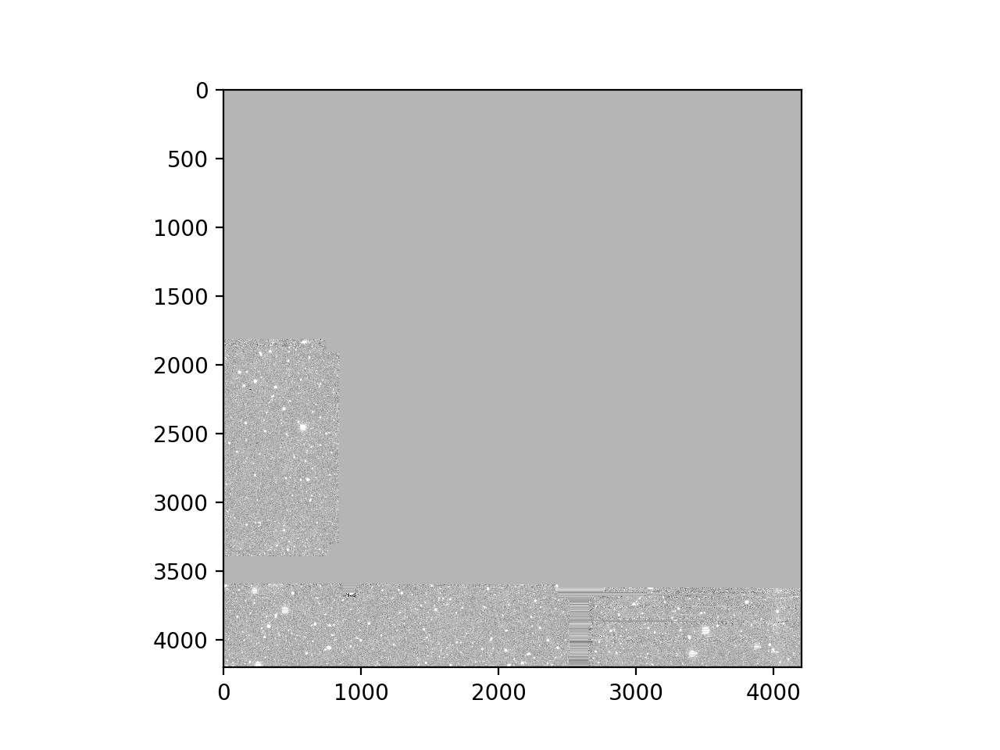

<IPython.core.display.Javascript object>


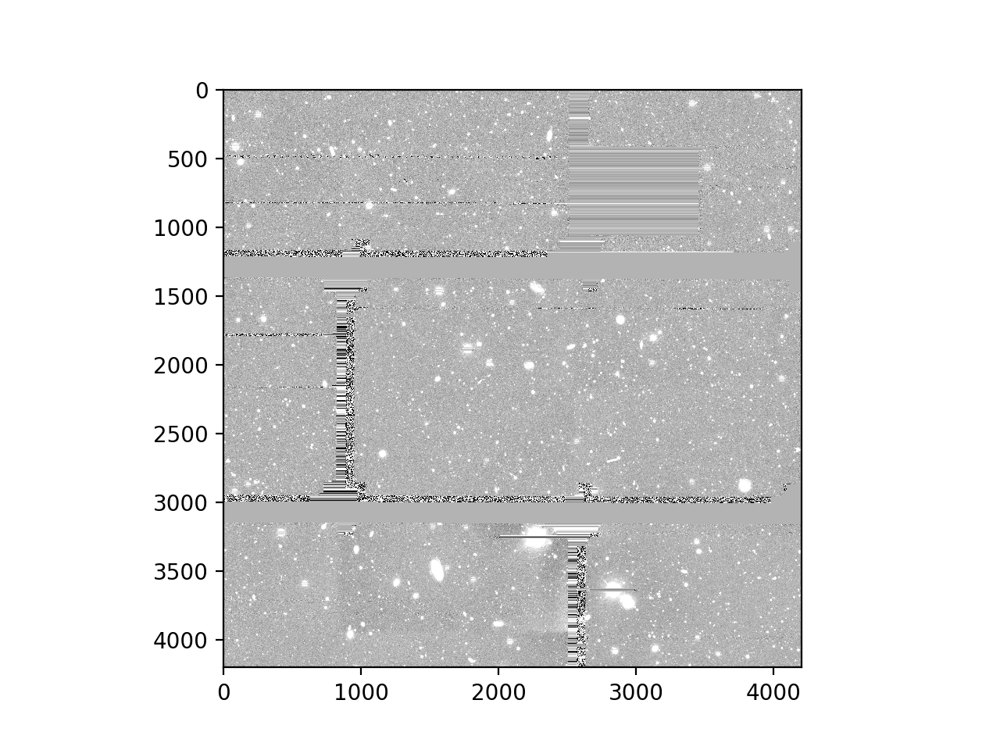

<IPython.core.display.Javascript object>


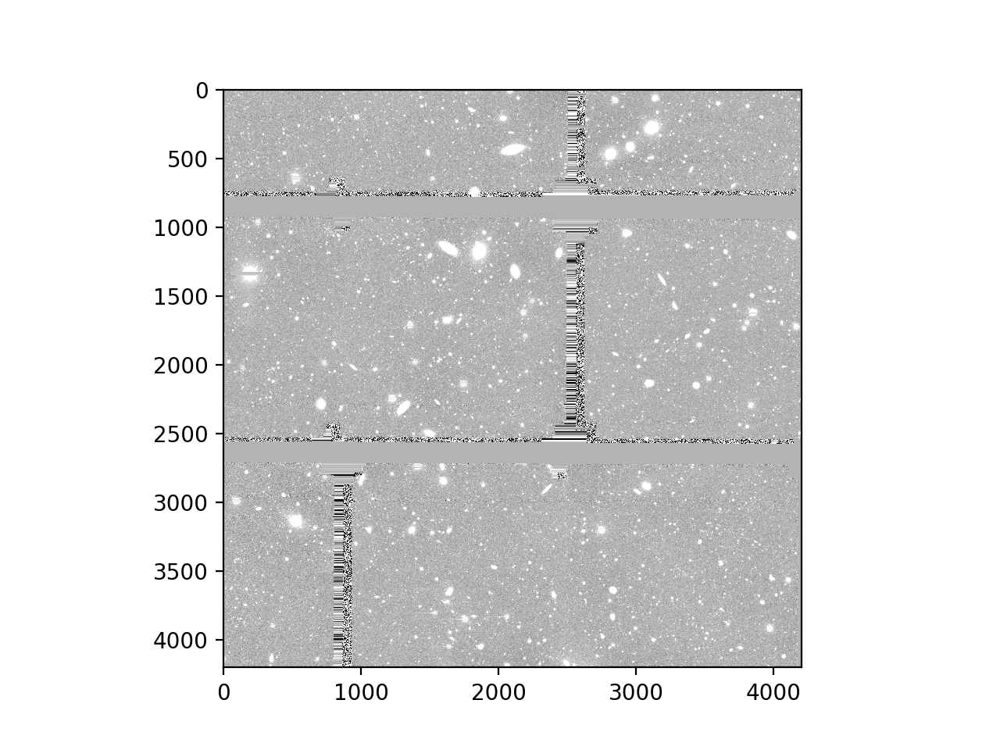

<IPython.core.display.Javascript object>


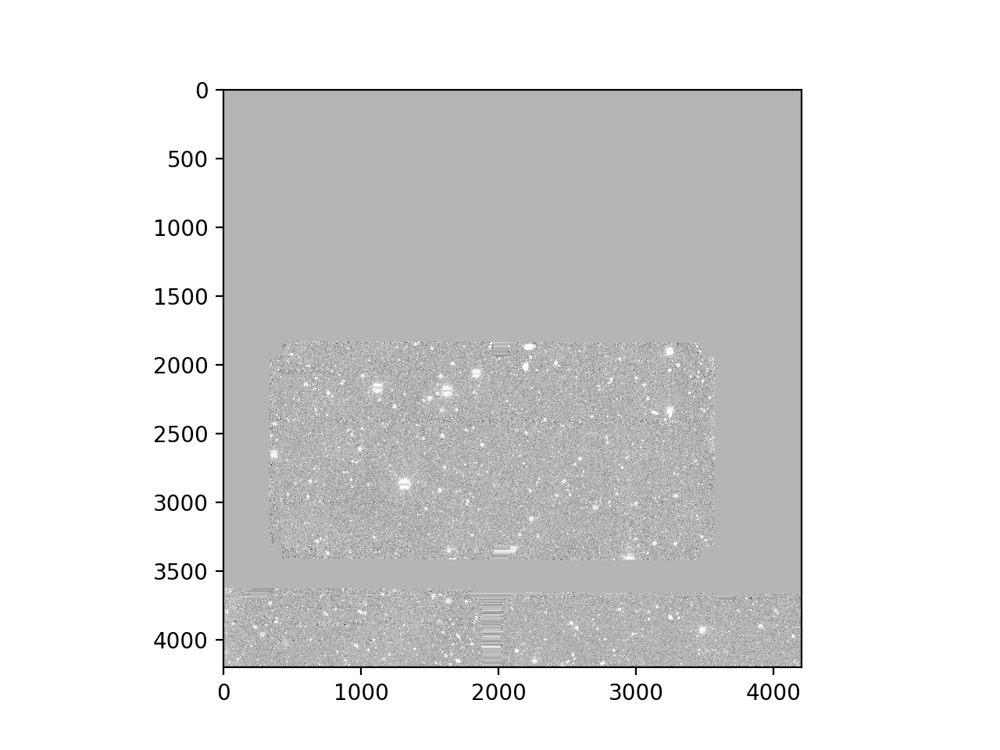

<IPython.core.display.Javascript object>


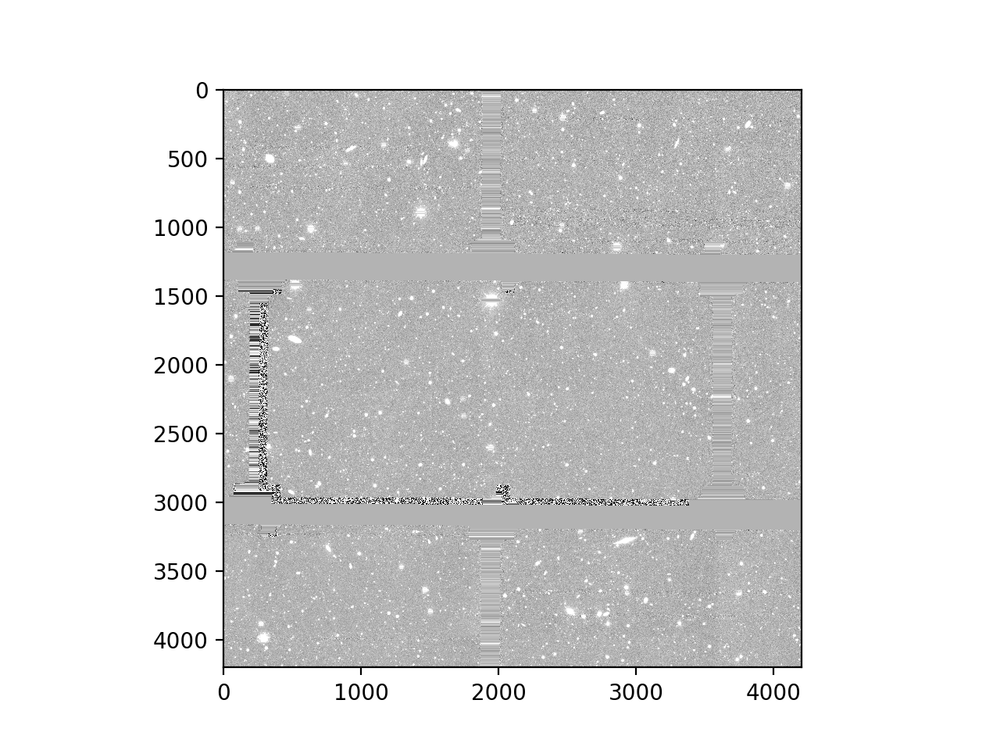

<IPython.core.display.Javascript object>


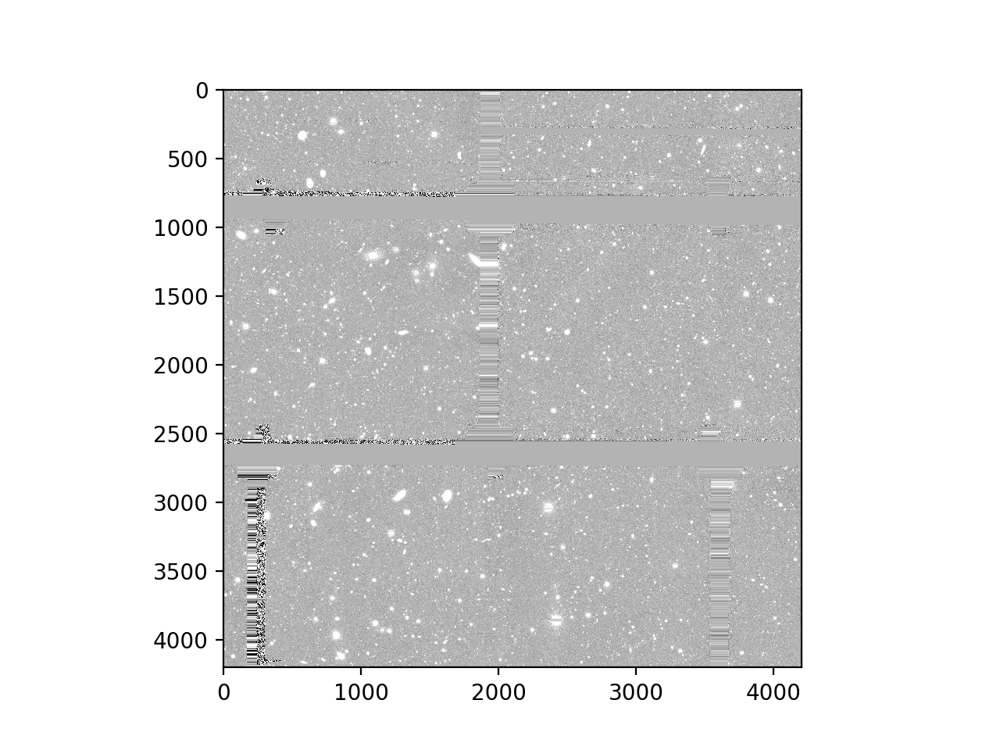

<IPython.core.display.Javascript object>


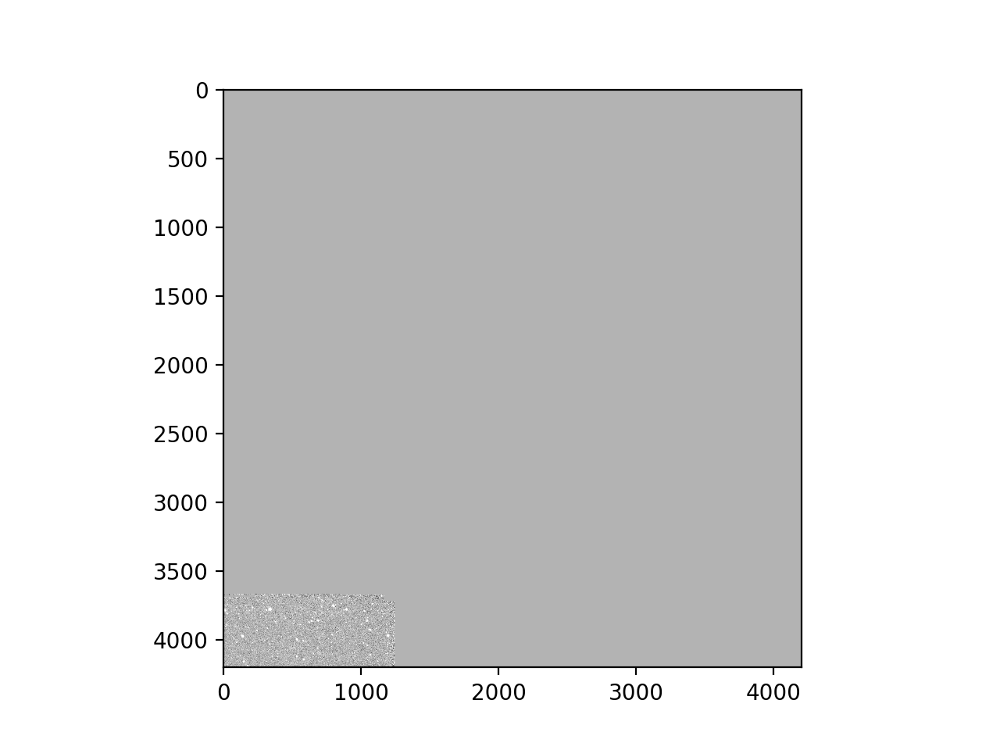

<IPython.core.display.Javascript object>


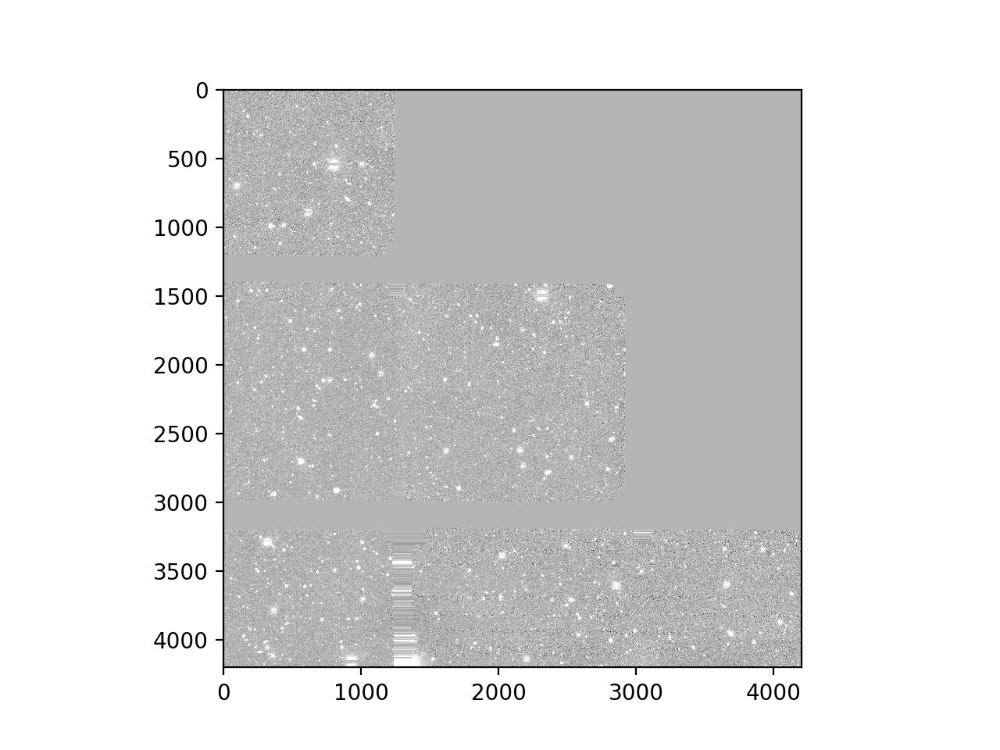

<IPython.core.display.Javascript object>


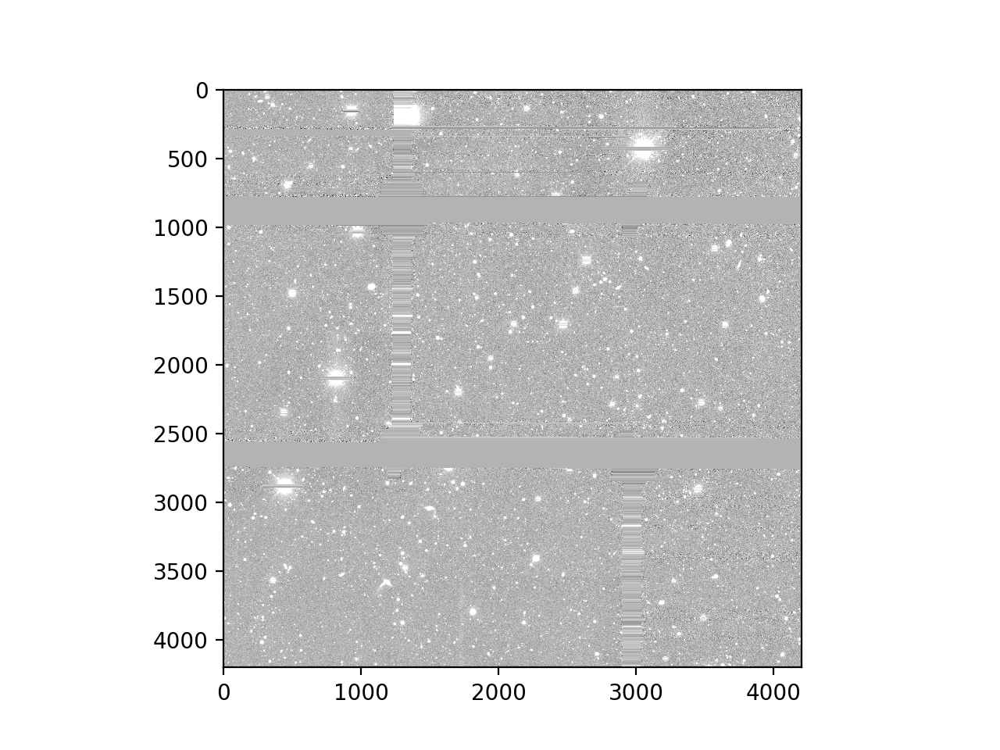

<IPython.core.display.Javascript object>


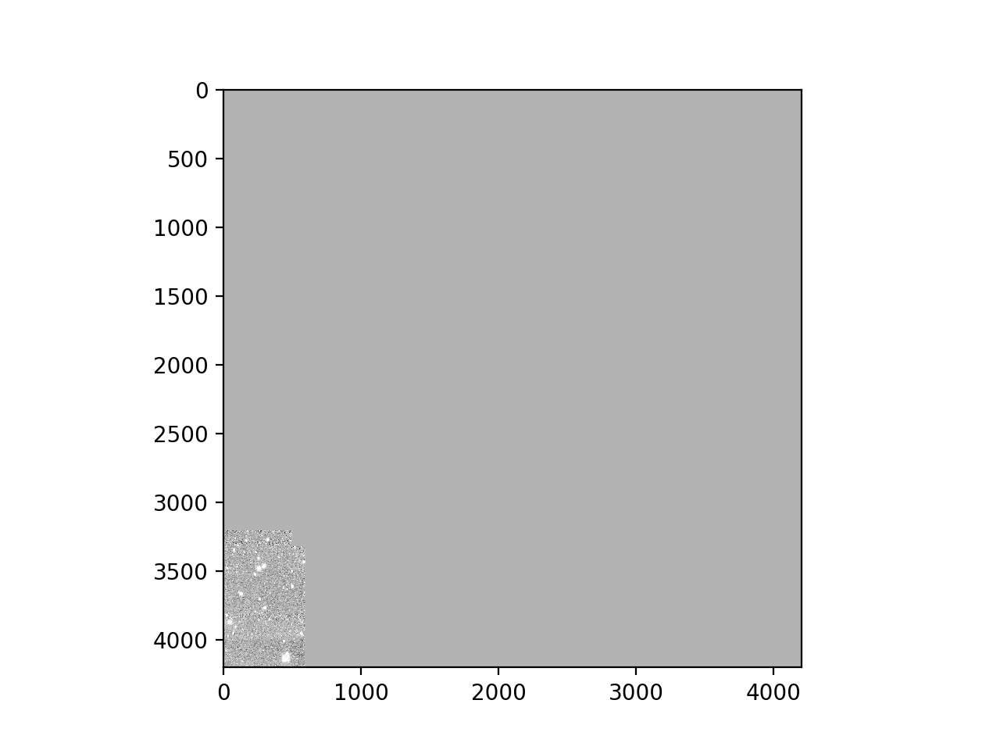

<IPython.core.display.Javascript object>


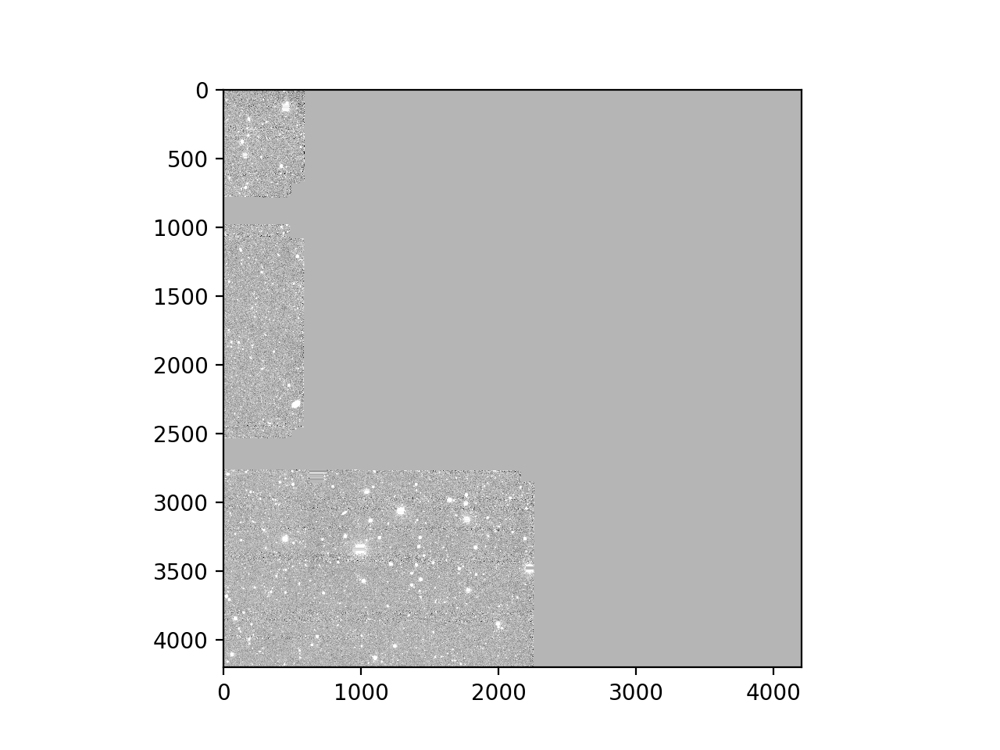

<IPython.core.display.Javascript object>


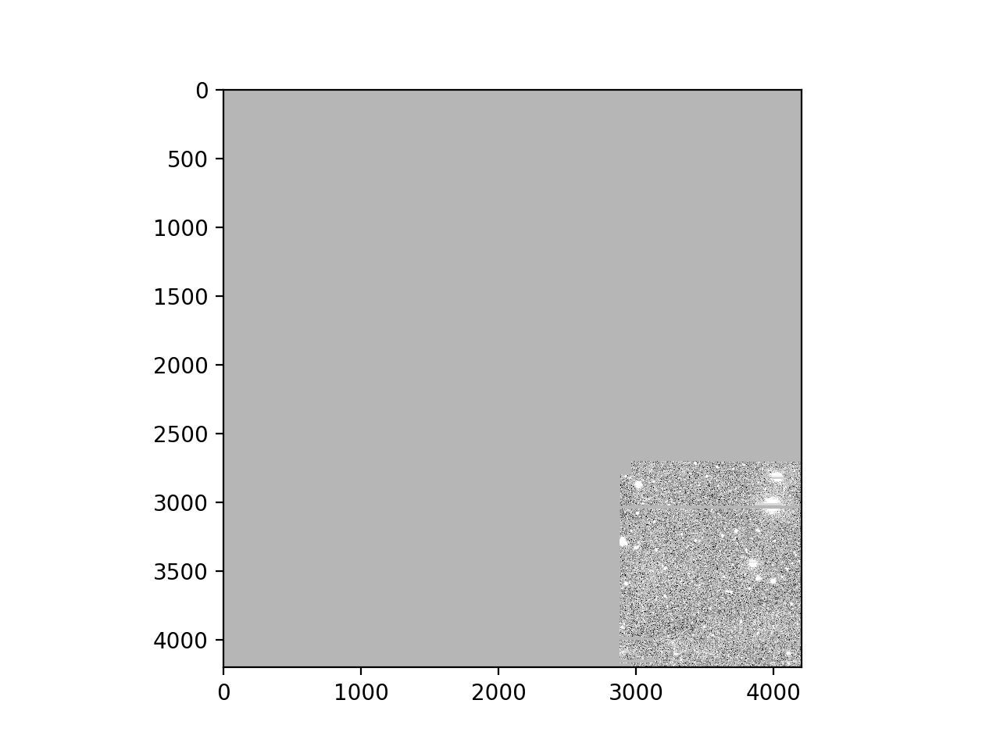

<IPython.core.display.Javascript object>


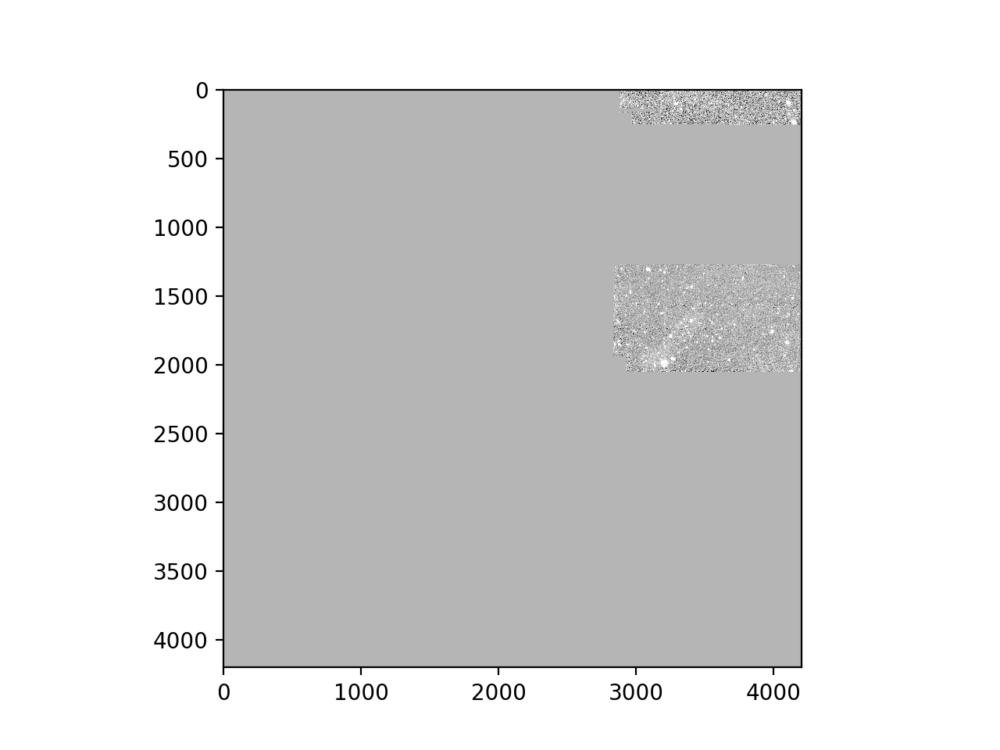

<IPython.core.display.Javascript object>


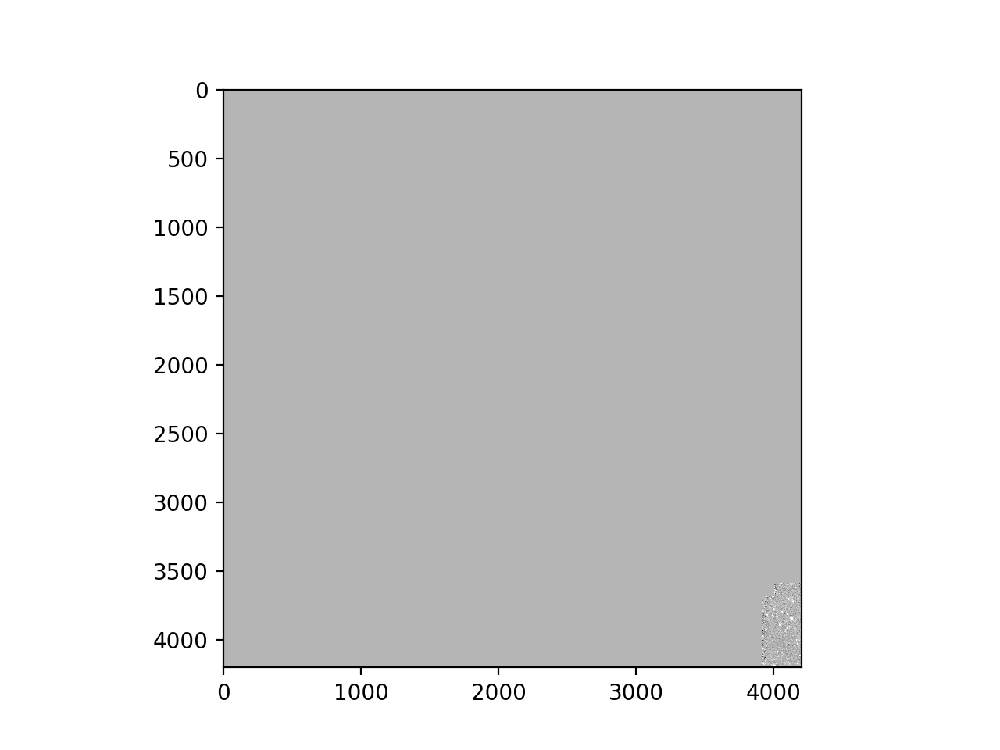

<IPython.core.display.Javascript object>


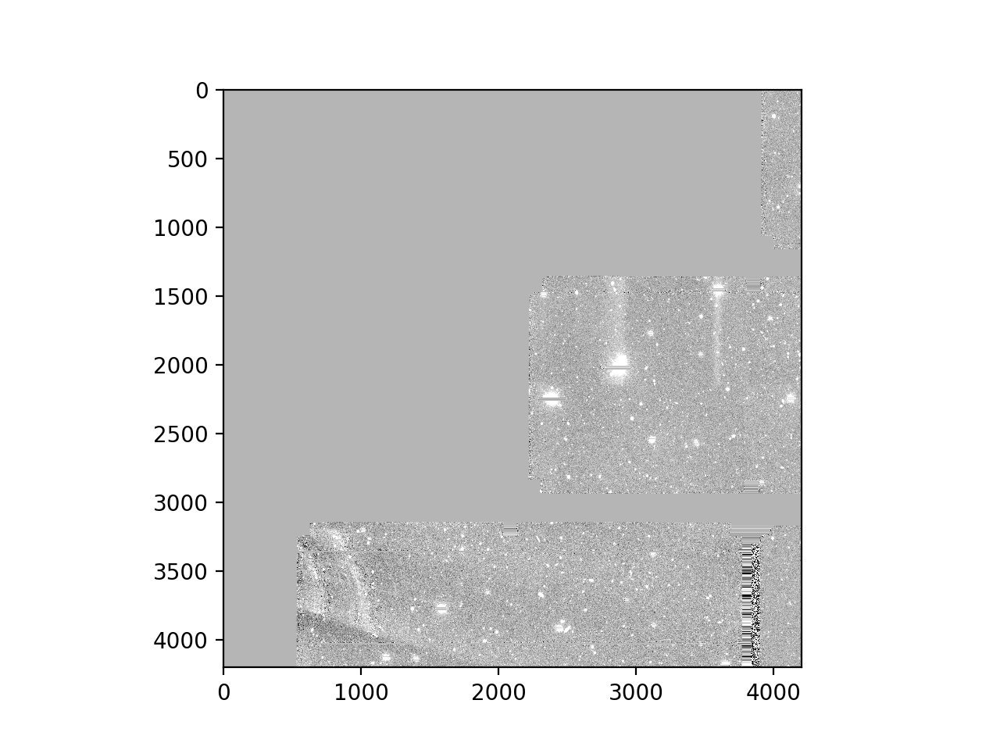

<IPython.core.display.Javascript object>


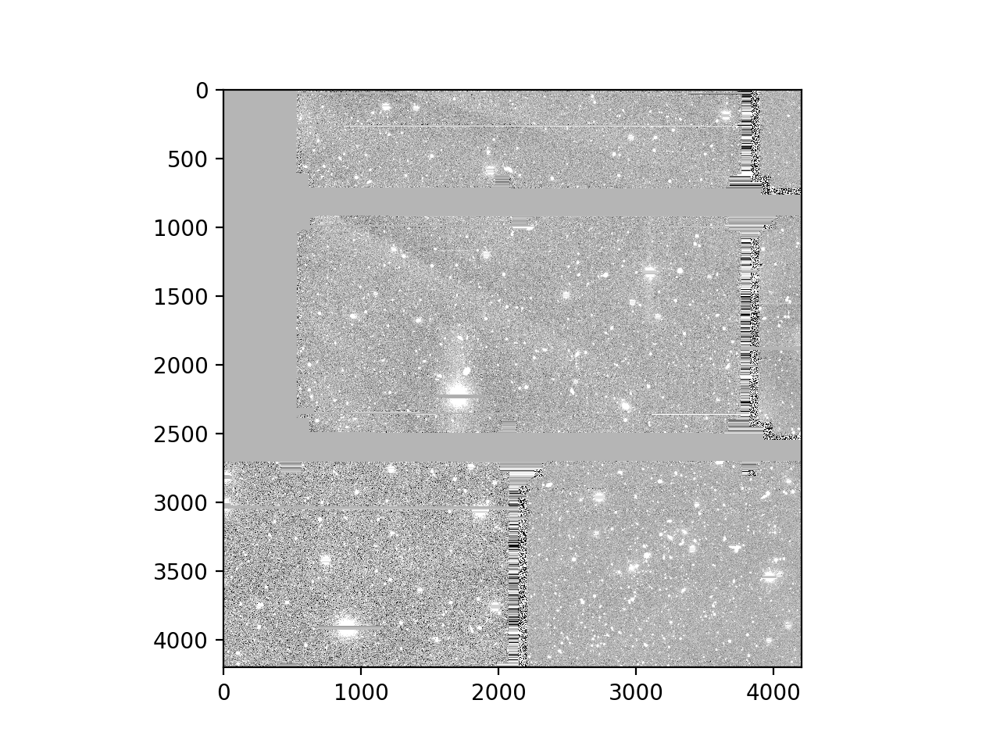

<IPython.core.display.Javascript object>


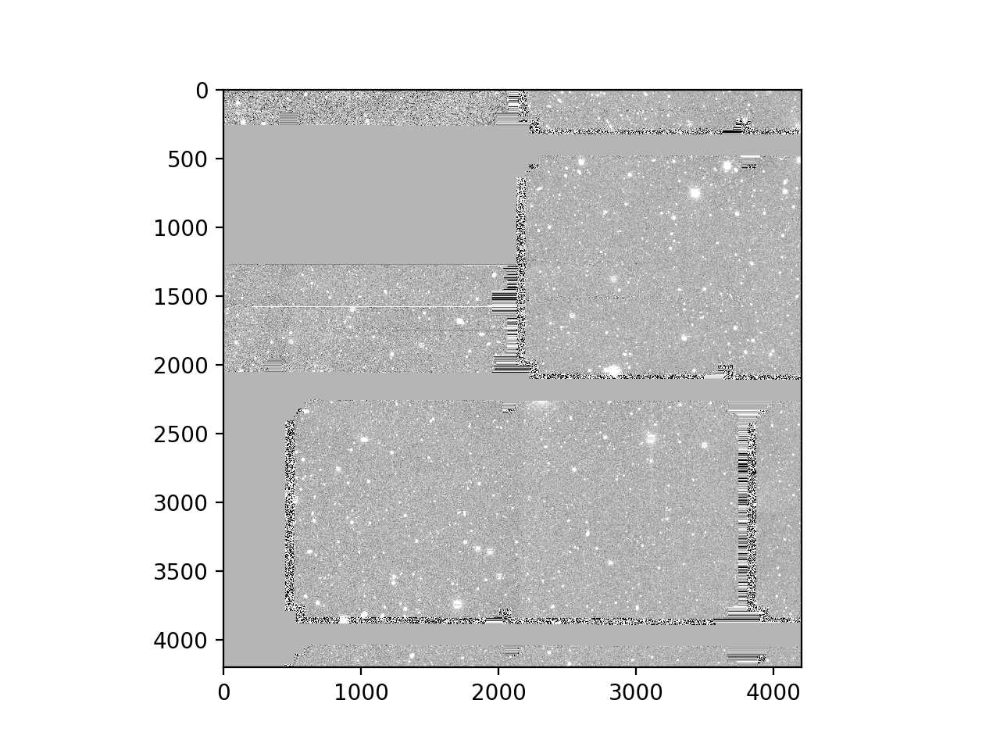

In [14]:
for patch in patchesMini:
    coaddDataId = {'filter': 'g', 'tract': 0, 'patch': patch}
    try:
        coadd = butler_good.get('deepCoaddPsfMatched', dataId=coaddDataId)
    except:
        print('FAILED TO DISPLAY patch', patch)
    else:
        figure = plt.figure()
        visitString = np.array2string(coadd.getInfo().getCoaddInputs().visits['id'])
        plt.imshow(coadd.getImage().getArray(), norm=norm, cmap='gray')

## That was fun, but we need to inspect the entire tract somehow

In [25]:
skymap1 = butler1.get('deepCoadd_skyMap', dataId=dataId1)
skymap_good = butler_good.get('deepCoadd_skyMap', dataId=dataId1)
#skymap_all = butler_all.get('deepCoadd_skyMap', dataId=dataId1)

In [16]:
patchesTest = [(int(item.split(',')[0]), int(item.split(',')[1])) for item in patchesAll]
(7, 10) in patchesTest

True

In [17]:
# Instead of using a manually defined patch list to figure out which patches
# have warps/coadds in them, go through each patch and try opening its coadd.
# If that succeeds, add the patch ID to our happy patch list.

for tractInfo in skymap_good:
    good_patch_list = [str(patch.getIndex()[0]) + ',' + str(patch.getIndex()[1]) for patch in tractInfo]
    better_patch_list = []
    for patch in good_patch_list:
        try:
            dataId = {'filter': 'g', 'tract': 0, 'patch': patch}
            coadd_test = butler_good.get('deepCoaddPsfMatched', dataId=dataId)
        except:
            print('No data in this patch', patch)
            continue
        else:
            print('This patch has a coadd', patch)
            better_patch_list.append(patch)

No data in this patch 0,0
No data in this patch 1,0
No data in this patch 2,0
No data in this patch 3,0
No data in this patch 4,0
No data in this patch 5,0
No data in this patch 6,0
No data in this patch 7,0
No data in this patch 8,0
No data in this patch 9,0
No data in this patch 10,0
No data in this patch 11,0
No data in this patch 12,0
No data in this patch 13,0
No data in this patch 14,0
No data in this patch 15,0
No data in this patch 16,0
No data in this patch 17,0
No data in this patch 18,0
No data in this patch 19,0
No data in this patch 20,0
No data in this patch 21,0
No data in this patch 22,0
No data in this patch 23,0
No data in this patch 24,0
No data in this patch 25,0
No data in this patch 26,0
No data in this patch 27,0
No data in this patch 28,0
No data in this patch 29,0
No data in this patch 30,0
No data in this patch 31,0
No data in this patch 32,0
No data in this patch 33,0
No data in this patch 34,0
No data in this patch 0,1
No data in this patch 1,1
No data in th

This patch has a coadd 7,9
This patch has a coadd 8,9
This patch has a coadd 9,9
This patch has a coadd 10,9
This patch has a coadd 11,9
This patch has a coadd 12,9
This patch has a coadd 13,9
No data in this patch 14,9
No data in this patch 15,9
No data in this patch 16,9
No data in this patch 17,9
No data in this patch 18,9
No data in this patch 19,9
No data in this patch 20,9
No data in this patch 21,9
No data in this patch 22,9
No data in this patch 23,9
No data in this patch 24,9
No data in this patch 25,9
No data in this patch 26,9
No data in this patch 27,9
No data in this patch 28,9
No data in this patch 29,9
No data in this patch 30,9
No data in this patch 31,9
No data in this patch 32,9
No data in this patch 33,9
No data in this patch 34,9
No data in this patch 0,10
No data in this patch 1,10
No data in this patch 2,10
No data in this patch 3,10
No data in this patch 4,10
No data in this patch 5,10
No data in this patch 6,10
This patch has a coadd 7,10
This patch has a coadd 

No data in this patch 16,18
No data in this patch 17,18
No data in this patch 18,18
No data in this patch 19,18
No data in this patch 20,18
No data in this patch 21,18
No data in this patch 22,18
No data in this patch 23,18
No data in this patch 24,18
No data in this patch 25,18
No data in this patch 26,18
No data in this patch 27,18
No data in this patch 28,18
No data in this patch 29,18
No data in this patch 30,18
No data in this patch 31,18
No data in this patch 32,18
No data in this patch 33,18
No data in this patch 34,18
No data in this patch 0,19
No data in this patch 1,19
No data in this patch 2,19
No data in this patch 3,19
No data in this patch 4,19
No data in this patch 5,19
No data in this patch 6,19
No data in this patch 7,19
No data in this patch 8,19
No data in this patch 9,19
No data in this patch 10,19
No data in this patch 11,19
No data in this patch 12,19
No data in this patch 13,19
No data in this patch 14,19
No data in this patch 15,19
No data in this patch 16,19
No

This patch has a coadd 22,27
This patch has a coadd 23,27
This patch has a coadd 24,27
This patch has a coadd 25,27
This patch has a coadd 26,27
This patch has a coadd 27,27
No data in this patch 28,27
No data in this patch 29,27
No data in this patch 30,27
No data in this patch 31,27
No data in this patch 32,27
No data in this patch 33,27
No data in this patch 34,27
No data in this patch 0,28
No data in this patch 1,28
No data in this patch 2,28
No data in this patch 3,28
No data in this patch 4,28
No data in this patch 5,28
No data in this patch 6,28
No data in this patch 7,28
No data in this patch 8,28
No data in this patch 9,28
No data in this patch 10,28
No data in this patch 11,28
No data in this patch 12,28
No data in this patch 13,28
No data in this patch 14,28
No data in this patch 15,28
No data in this patch 16,28
No data in this patch 17,28
No data in this patch 18,28
No data in this patch 19,28
No data in this patch 20,28
No data in this patch 21,28
This patch has a coadd 2

In [18]:
# The same as above, but for coadds1

for tractInfo in skymap1:
    all_patch_list = [str(patch.getIndex()[0]) + ',' + str(patch.getIndex()[1]) for patch in tractInfo]
    aller_patch_list = []
    for patch in all_patch_list:
        try:
            dataId = {'filter': 'g', 'tract': 0, 'patch': patch}
            coadd_test = butler1.get('deepCoaddPsfMatched', dataId=dataId)
        except:
            print('No data in this patch', patch)
            continue
        else:
            print('This patch has a coadd', patch)
            aller_patch_list.append(patch)

No data in this patch 0,0
No data in this patch 1,0
No data in this patch 2,0
No data in this patch 3,0
No data in this patch 4,0
No data in this patch 5,0
No data in this patch 6,0
No data in this patch 7,0
No data in this patch 8,0
No data in this patch 9,0
No data in this patch 10,0
No data in this patch 11,0
No data in this patch 12,0
No data in this patch 13,0
No data in this patch 14,0
No data in this patch 15,0
No data in this patch 16,0
No data in this patch 17,0
No data in this patch 18,0
No data in this patch 19,0
No data in this patch 20,0
No data in this patch 21,0
No data in this patch 22,0
No data in this patch 23,0
No data in this patch 24,0
No data in this patch 25,0
No data in this patch 26,0
No data in this patch 27,0
No data in this patch 28,0
No data in this patch 29,0
No data in this patch 30,0
No data in this patch 31,0
No data in this patch 32,0
No data in this patch 33,0
No data in this patch 34,0
No data in this patch 0,1
No data in this patch 1,1
No data in th

This patch has a coadd 7,9
This patch has a coadd 8,9
This patch has a coadd 9,9
This patch has a coadd 10,9
This patch has a coadd 11,9
This patch has a coadd 12,9
This patch has a coadd 13,9
No data in this patch 14,9
No data in this patch 15,9
No data in this patch 16,9
No data in this patch 17,9
No data in this patch 18,9
No data in this patch 19,9
No data in this patch 20,9
No data in this patch 21,9
No data in this patch 22,9
No data in this patch 23,9
No data in this patch 24,9
No data in this patch 25,9
No data in this patch 26,9
No data in this patch 27,9
No data in this patch 28,9
No data in this patch 29,9
No data in this patch 30,9
No data in this patch 31,9
No data in this patch 32,9
No data in this patch 33,9
No data in this patch 34,9
No data in this patch 0,10
No data in this patch 1,10
No data in this patch 2,10
No data in this patch 3,10
No data in this patch 4,10
No data in this patch 5,10
No data in this patch 6,10
This patch has a coadd 7,10
This patch has a coadd 

This patch has a coadd 17,18
This patch has a coadd 18,18
This patch has a coadd 19,18
No data in this patch 20,18
No data in this patch 21,18
No data in this patch 22,18
No data in this patch 23,18
No data in this patch 24,18
No data in this patch 25,18
No data in this patch 26,18
No data in this patch 27,18
No data in this patch 28,18
No data in this patch 29,18
No data in this patch 30,18
No data in this patch 31,18
No data in this patch 32,18
No data in this patch 33,18
No data in this patch 34,18
No data in this patch 0,19
No data in this patch 1,19
No data in this patch 2,19
No data in this patch 3,19
No data in this patch 4,19
No data in this patch 5,19
No data in this patch 6,19
No data in this patch 7,19
No data in this patch 8,19
No data in this patch 9,19
No data in this patch 10,19
No data in this patch 11,19
No data in this patch 12,19
No data in this patch 13,19
No data in this patch 14,19
No data in this patch 15,19
No data in this patch 16,19
No data in this patch 17,19

No data in this patch 19,27
No data in this patch 20,27
No data in this patch 21,27
This patch has a coadd 22,27
This patch has a coadd 23,27
This patch has a coadd 24,27
This patch has a coadd 25,27
This patch has a coadd 26,27
This patch has a coadd 27,27
No data in this patch 28,27
No data in this patch 29,27
No data in this patch 30,27
No data in this patch 31,27
No data in this patch 32,27
No data in this patch 33,27
No data in this patch 34,27
No data in this patch 0,28
No data in this patch 1,28
No data in this patch 2,28
No data in this patch 3,28
No data in this patch 4,28
No data in this patch 5,28
No data in this patch 6,28
No data in this patch 7,28
No data in this patch 8,28
No data in this patch 9,28
No data in this patch 10,28
No data in this patch 11,28
No data in this patch 12,28
No data in this patch 13,28
No data in this patch 14,28
No data in this patch 15,28
No data in this patch 16,28
No data in this patch 17,28
No data in this patch 18,28
No data in this patch 19

In [21]:
# Wildly pasting some pipe_analysis plotting stuff into here... and editing it a bit to suck slightly less...

def percent(values, p=0.5):
    """Return a value a faction of the way between the min and max values in a list."""
    m = min(values)
    interval = max(values) - m
    return m + p*interval

def bboxToRaDec(bbox, wcs):
    """Get the corners of a BBox and convert them to lists of RA and Dec."""
    corners = []
    for corner in bbox.getCorners():
        p = afwGeom.Point2D(corner.getX(), corner.getY())
        coord = wcs.pixelToSky(p)
        corners.append([coord.getRa().asDegrees(), coord.getDec().asDegrees()])
    ra, dec = zip(*corners)
    return ra, dec

def getRaDecMinMaxPatchList(patchList, tractInfo, pad=0.0, nDecimals=4, raMin=360.0, raMax=0.0,
                            decMin=90.0, decMax=-90.0):
    """Find the max and min RA and DEC (deg) boundaries encompased in the patchList
    Parameters
    ----------
    patchList : `list` of `str`
       List of patch IDs.
    tractInfo : `lsst.skymap.tractInfo.ExplicitTractInfo`
       Tract information associated with the patches in patchList
    pad : `float`
       Pad the boundary by pad degrees
    nDecimals : `int`
       Round coordinates to this number of decimal places
    raMin, raMax : `float`
       Initiate minimum[maximum] RA determination at raMin[raMax] (deg)
    decMin, decMax : `float`
       Initiate minimum[maximum] DEC determination at decMin[decMax] (deg)
    Returns
    -------
    `lsst.pipe.base.Struct`
       Contains the ra and dec min and max values for the patchList provided
    """
    for ip, patch in enumerate(tractInfo):
        if str(patch.getIndex()[0])+","+str(patch.getIndex()[1]) in patchList:
            raPatch, decPatch = bboxToRaDec(patch.getOuterBBox(), tractInfo.getWcs())
            raMin = min(np.round(min(raPatch) - pad, nDecimals), raMin)
            raMax = max(np.round(max(raPatch) + pad, nDecimals), raMax)
            decMin = min(np.round(min(decPatch) - pad, nDecimals), decMin)
            decMax = max(np.round(max(decPatch) + pad, nDecimals), decMax)
    return Struct(
        raMin = raMin,
        raMax = raMax,
        decMin = decMin,
        decMax = decMax,
    )

def plotTractOutline(axes, tractInfo, patchList, fontSize=5, maxDegBeyondPatch=1.5):
    """Plot the the outline of the tract and patches highlighting those with data
    As some skyMap settings can define tracts with a large number of patches, this can
    become very crowded.  So, if only a subset of patches are included, find the outer
    boudary of all patches in patchList and only plot to maxDegBeyondPatch degrees
    beyond those boundaries (in all four directions).
    Parameters
    ----------
    tractInfo : `lsst.skymap.tractInfo.ExplicitTractInfo`
       Tract information object for extracting tract RA and DEC limits.
    patchList : `list` of `str`
       List of patch IDs with data to be plotted.  These will be color shaded in the outline plot.
    fontSize : `int`
       Font size for plot labels.
    maxDegBeyondPatch : `float`
       Maximum number of degrees to plot beyond the border defined by all patches with data to be plotted.
    """
    buff = 0.02
    axes.tick_params(which="both", direction="in", labelsize=fontSize)
    axes.locator_params(nbins=6)
    axes.ticklabel_format(useOffset=False)

    tractRa, tractDec = bboxToRaDec(tractInfo.getBBox(), tractInfo.getWcs())
    patchBoundary = getRaDecMinMaxPatchList(patchList, tractInfo, pad=maxDegBeyondPatch)

    xMin = min(max(tractRa), patchBoundary.raMax) + buff
    xMax = max(min(tractRa), patchBoundary.raMin) - buff
    yMin = max(min(tractDec), patchBoundary.decMin) - buff
    yMax = min(max(tractDec), patchBoundary.decMax) + buff
    xlim = xMin, xMax
    ylim = yMin, yMax
    axes.fill(tractRa, tractDec, fill=True, edgecolor='k', lw=1, linestyle='solid',
              color="black", alpha=0.2)
    for ip, patch in enumerate(tractInfo):
        patchIndexStr = str(patch.getIndex()[0]) + "," + str(patch.getIndex()[1])
        color = "k"
        alpha = 0.05
        if patchIndexStr in patchList:
            #color = ("c", "g", "r", "b", "m")[ip%5]
            color='g'
            alpha = 0.5
        ra, dec = bboxToRaDec(patch.getOuterBBox(), tractInfo.getWcs())
        deltaRa = abs(max(ra) - min(ra))
        deltaDec = abs(max(dec) - min(dec))
        pBuff = 0.5*max(deltaRa, deltaDec)
        centerRa = min(ra) + 0.5*deltaRa
        centerDec = min(dec) + 0.5*deltaDec
        if (centerRa < xMin + pBuff and centerRa > xMax - pBuff and
                centerDec > yMin - pBuff and centerDec < yMax + pBuff):
            axes.fill(ra, dec, fill=True, color=color, lw=1, linestyle="solid", alpha=alpha)
            if patchIndexStr in patchList or (centerRa < xMin - 0.2*pBuff and
                                              centerRa > xMax + 0.2*pBuff and
                                              centerDec > yMin + 0.2*pBuff and
                                              centerDec < yMax - 0.2*pBuff):
                axes.text(percent(ra), percent(dec, 0.5), str(patchIndexStr),
                          fontsize=fontSize - 1, horizontalalignment="center", verticalalignment="center")
    #axes.text(percent((xMin, xMax), 1.06), percent((yMin, yMax), -0.08), "RA",
    #          fontsize=fontSize, horizontalalignment="center", verticalalignment="center", color="k")
    #axes.text(percent((xMin, xMax), 1.15), percent((yMin, yMax), 0.01), "Dec",
    #          fontsize=fontSize, horizontalalignment="center", verticalalignment="center",
    #          rotation="vertical", color="k")
    axes.set_xlabel('RA', size='large')
    axes.set_ylabel('Dec', size='large')
    axes.set_xlim(xlim)
    axes.set_ylim(ylim)

In [22]:
print(better_patch_list)  # coadds_good
print(aller_patch_list)  # coadds1

['9,3', '10,3', '11,3', '12,3', '13,3', '9,4', '10,4', '11,4', '12,4', '13,4', '14,4', '8,5', '9,5', '10,5', '11,5', '12,5', '13,5', '14,5', '8,6', '9,6', '10,6', '11,6', '12,6', '13,6', '14,6', '9,7', '10,7', '11,7', '12,7', '13,7', '14,7', '8,8', '9,8', '10,8', '11,8', '12,8', '13,8', '7,9', '8,9', '9,9', '10,9', '11,9', '12,9', '13,9', '7,10', '8,10', '9,10', '10,10', '11,10', '12,10', '13,10', '8,11', '9,11', '10,11', '11,11', '12,11', '13,11', '8,12', '9,12', '10,12', '11,12', '12,12', '22,27', '23,27', '24,27', '25,27', '26,27', '27,27', '22,28', '23,28', '24,28', '25,28', '26,28', '27,28', '22,29', '23,29', '24,29', '25,29', '26,29', '27,29', '28,29', '22,30', '23,30', '24,30', '25,30', '26,30', '27,30', '28,30', '22,31', '23,31', '24,31', '25,31', '26,31', '27,31', '23,32', '24,32']
['9,3', '10,3', '11,3', '12,3', '13,3', '9,4', '10,4', '11,4', '12,4', '13,4', '14,4', '8,5', '9,5', '10,5', '11,5', '12,5', '13,5', '14,5', '8,6', '9,6', '10,6', '11,6', '12,6', '13,6', '14,6', '9,

/software/lsstsw/stack_20181012/python/miniconda3-4.5.4/envs/lsst-scipipe/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


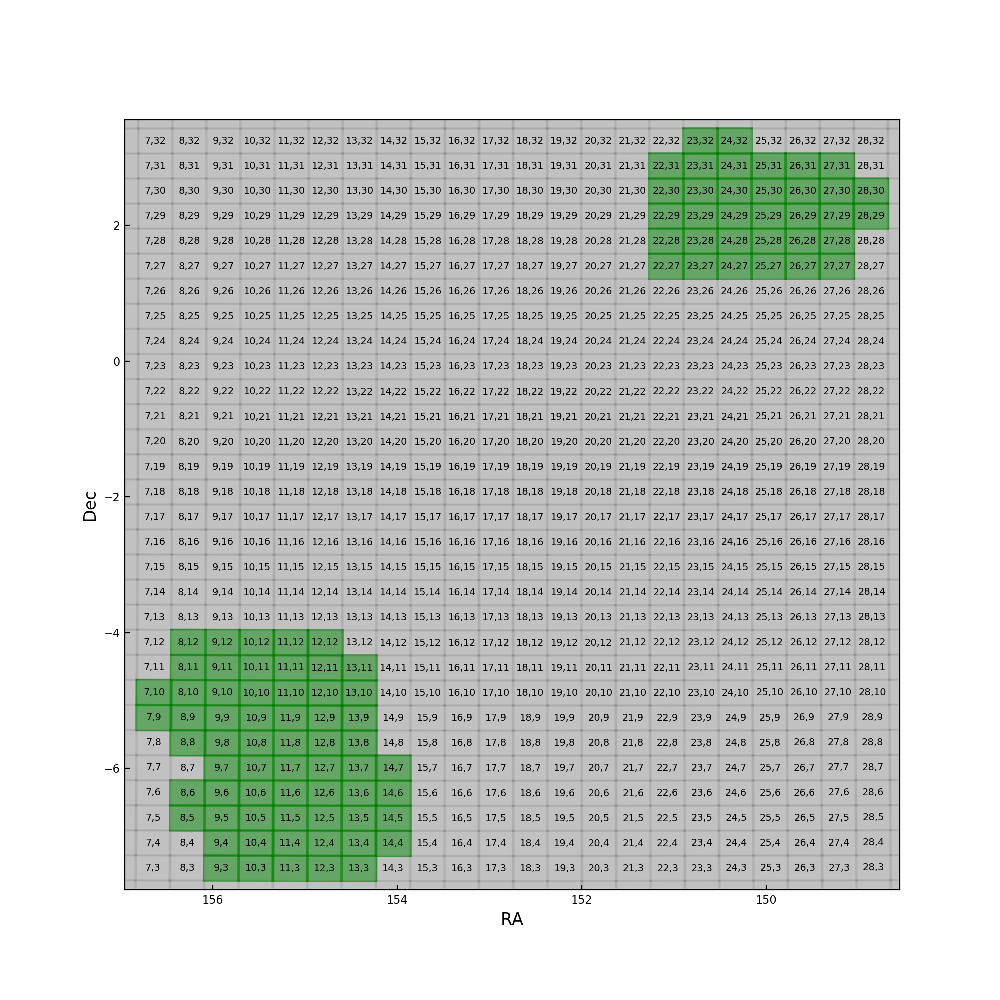

In [23]:
fig = plt.figure(figsize=(10,10))
axes = fig.gca()
plotTractOutline(axes, tractInfo=skymap_good[0], patchList=better_patch_list, fontSize=8, maxDegBeyondPatch=0.1)

/software/lsstsw/stack_20181012/python/miniconda3-4.5.4/envs/lsst-scipipe/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


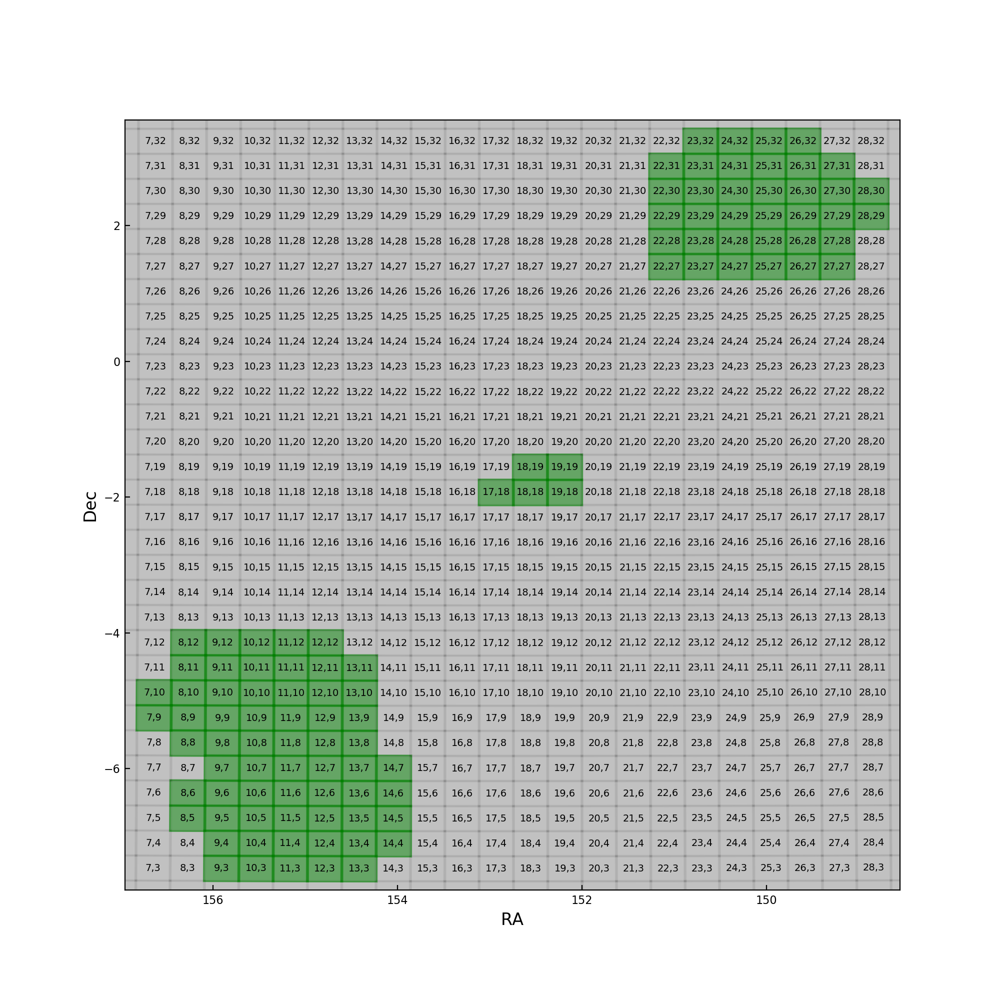

In [26]:
fig = plt.figure(figsize=(10,10))
axes = fig.gca()
plotTractOutline(axes, tractInfo=skymap1[0], patchList=aller_patch_list, fontSize=8, maxDegBeyondPatch=0.1)

In [27]:
badPatches = ['17,18', '18,18', '18,19', '19,18', '19,19']
badPatchesTuple = [(17, 18), (18, 18), (18, 19), (19, 18), (19, 19)]

In [28]:
for patch in badPatches:
    coaddDataId = {'filter': 'g', 'tract': 0, 'patch': patch}
    try:
        coadd = butler1.get('deepCoaddPsfMatched', dataId=coaddDataId)
        figure = plt.figure()
        visitCcdString = np.array2string(coadd.getInfo().getCoaddInputs().ccds['id'])
        plt.imshow(coadd.getImage().getArray(), norm=norm, cmap='gray')
        plt.title(visitCcdString)
    except:
        print('NO COADD FOR BAD PATCH', patch)

/software/lsstsw/stack_20181012/python/miniconda3-4.5.4/envs/lsst-scipipe/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## We've determined the visit causing the erroneous patches is 289818

When we try to retrieve warps for those patches, it (correctly) fails. But when we try to retrieve coadds, it thinks there is something there from visit 289818. The ccdnums are 16, 22, and 23.

In [ ]:
butlerCalexp = dafPersist.Butler('/project/mrawls/hits2014/ingested/rerun/processed1')

In [ ]:
dataIdsCalexp = [{'visit': 289818, 'ccdnum': 16}, {'visit': 289818, 'ccdnum': 22}, {'visit': 289818, 'ccdnum': 23}]

In [ ]:
for dataId in dataIdsCalexp:
    calexp = butler1.get('calexp', dataId=dataId)
    figure = plt.figure()
    plt.imshow(calexp.getImage().getArray(), norm=norm, cmap='gray')

## OK, this just plots the calexps in pixel space, but we legit need to plot them on the sky.

In [ ]:
for patch in badPatches:
    try:
        warpDataId = {'visit': 289818, 'tract': 0, 'patch': patch}
        warp = butler1.get('deepCoadd_psfMatchedWarp', dataId=warpDataId)
        figure = plt.figure()
        plt.imshow(warp.getImage().getArray(), norm=norm, cmap='gray')
    except:
        print('NO WARPS FOR BAD PATCH', patch)

## one step closer, this plots the warps in pixel space, but for serious, we need to plot them on the sky

In [ ]:
for patch, patchTuple in zip(badPatches, badPatchesTuple):
    coaddDataId = {'filter': 'g', 'tract': 0, 'patch': patch}
    warpDataId = {'visit': 289818, 'tract': 0, 'patch': patch}
    skymap = butler1.get('deepCoadd_skyMap', dataId=coaddDataId)
    tractInfo = skymap[0]
    realPatch = tractInfo.getPatchInfo((int(patch.split(',')[0]), int(patch.split(',')[1])))
    ra, dec = bboxToRaDec(realPatch.getOuterBBox(), tractInfo.getWcs())
    print(ra, dec)

The reason for this is still unclear... but we can at least demonstrate that the new "good" coadds don't have holes in them like they did originally.

### Investigation into a patch that originally had a "hole" in it, but is probably fine now

In [ ]:
weirdPatchId = {'filter': 'g', 'tract': 0, 'patch': '11,9'}
coaddWeird1 = butler1.get('deepCoaddPsfMatched', dataId=weirdPatchId)

In [ ]:
coaddWeird1.getInfo().getCoaddInputs().ccds

In [ ]:
coaddWeird1.getInfo().getCoaddInputs().visits

In [ ]:
coaddWeirdGood = butler_good.get('deepCoaddPsfMatched', dataId=weirdPatchId)

In [ ]:
coaddWeirdGood.getInfo().getCoaddInputs().ccds

In [ ]:
coaddWeirdGood.getInfo().getCoaddInputs().visits